# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels,n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()), 1)
    #### END CODE HERE ####
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.1170962949991226, discriminator loss: 0.27291767167299985


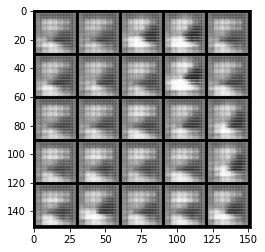

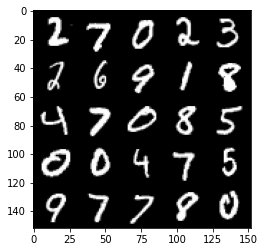

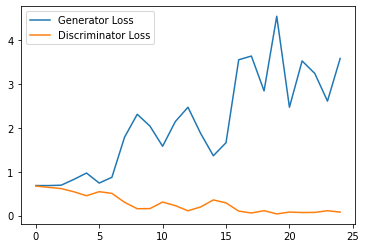

Step 1000: Generator loss: 4.062509502887726, discriminator loss: 0.0759456089399755


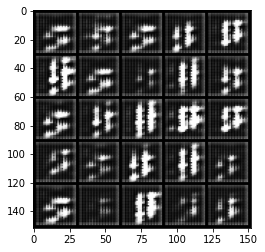

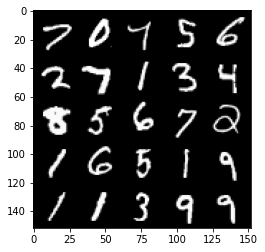

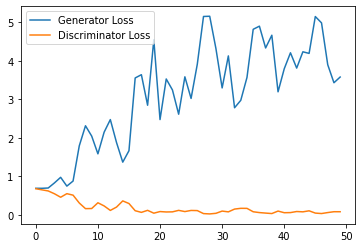

Step 1500: Generator loss: 3.3873745152950288, discriminator loss: 0.10829900669679046


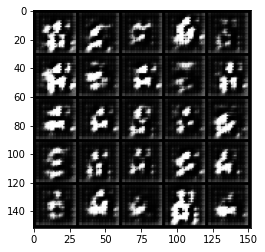

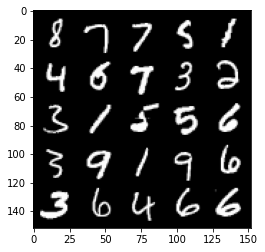

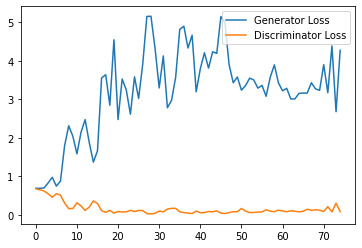

Step 2000: Generator loss: 2.836684664726257, discriminator loss: 0.19854071648418903


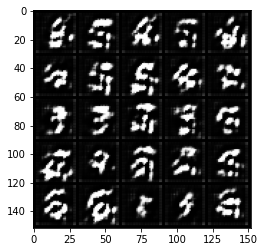

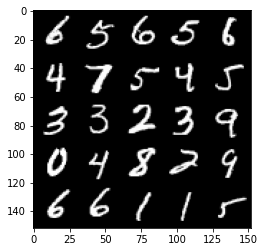

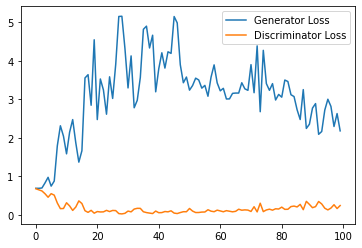

Step 2500: Generator loss: 2.165984275341034, discriminator loss: 0.30313217279314997


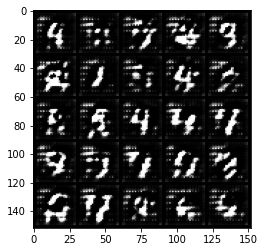

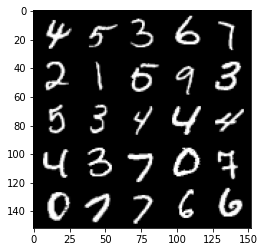

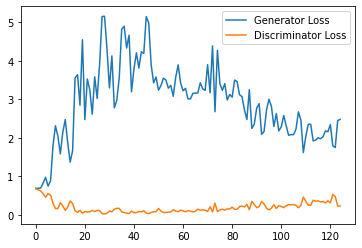

Step 3000: Generator loss: 2.0535761888027193, discriminator loss: 0.30710883827507496


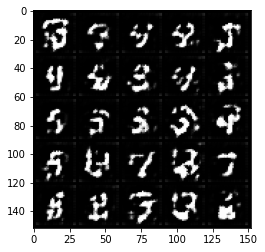

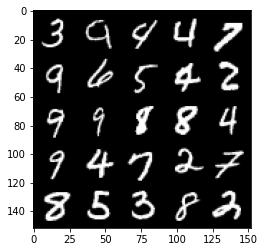

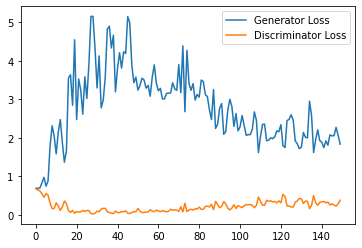

Step 3500: Generator loss: 2.1819197025299073, discriminator loss: 0.2848425126671791


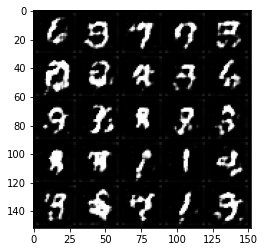

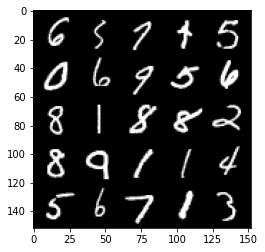

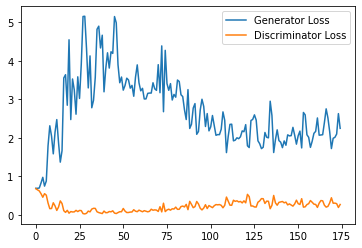

Step 4000: Generator loss: 2.0634980084896086, discriminator loss: 0.3259690360426903


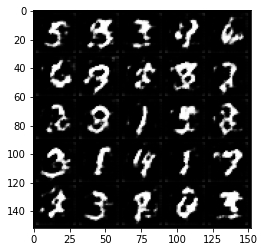

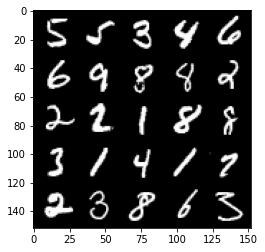

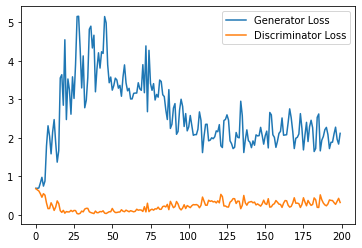

Step 4500: Generator loss: 2.0733212559223175, discriminator loss: 0.3233292757868767


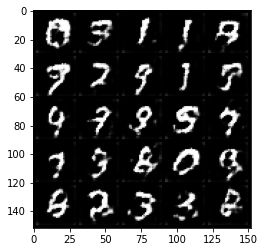

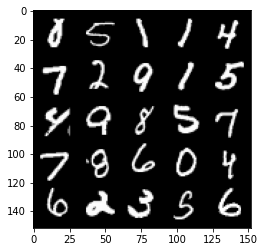

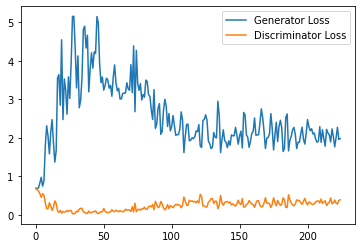

Step 5000: Generator loss: 2.0066066637039186, discriminator loss: 0.3574001341164112


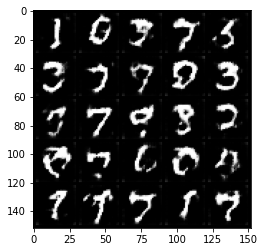

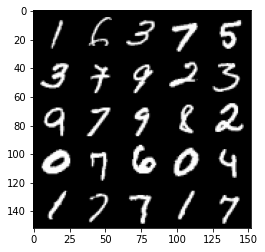

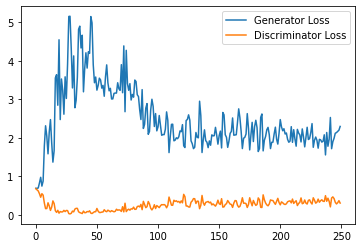

Step 5500: Generator loss: 1.7258021306991578, discriminator loss: 0.3848859552741051


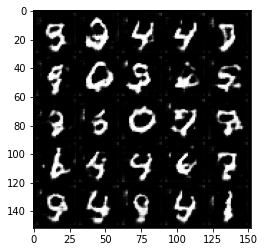

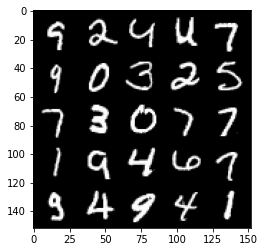

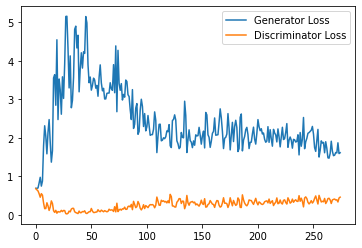

Step 6000: Generator loss: 1.7060316622257232, discriminator loss: 0.3941169674992561


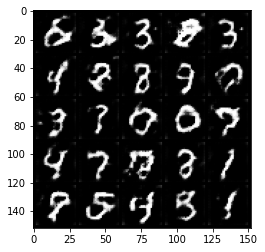

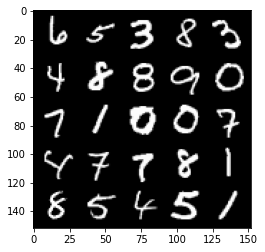

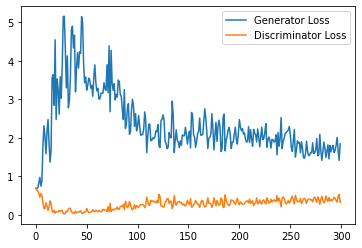

Step 6500: Generator loss: 1.770724012851715, discriminator loss: 0.40382673251628876


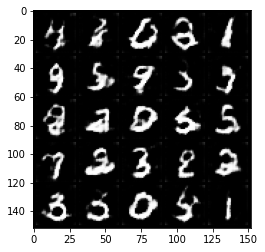

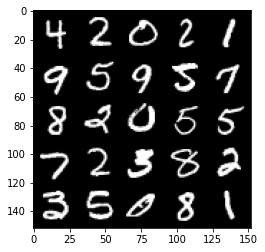

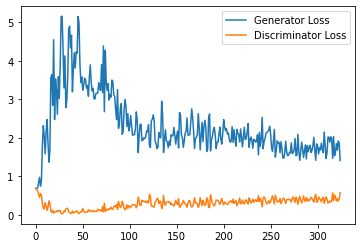

Step 7000: Generator loss: 1.6734838018417357, discriminator loss: 0.4091504128575325


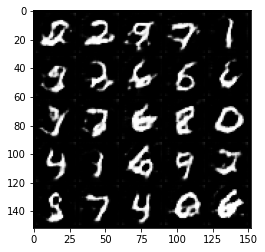

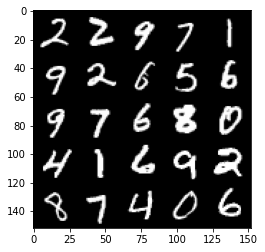

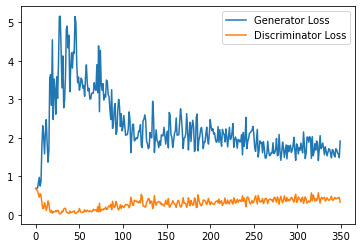

Step 7500: Generator loss: 1.5001197398900985, discriminator loss: 0.4534585905075073


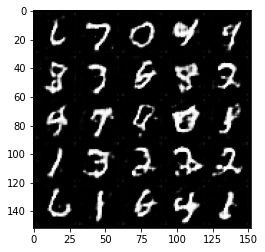

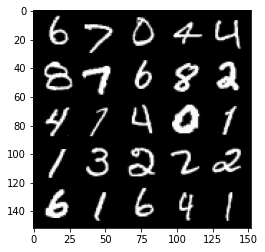

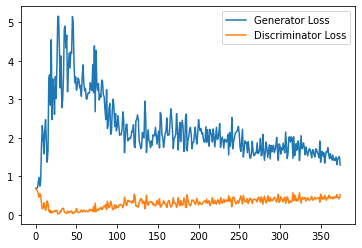

Step 8000: Generator loss: 1.4694130709171296, discriminator loss: 0.46560435223579405


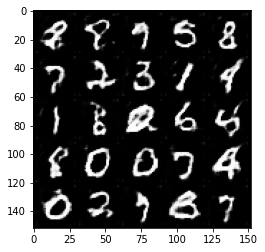

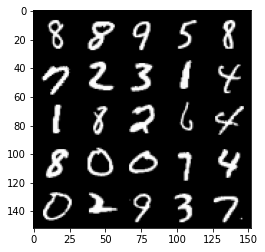

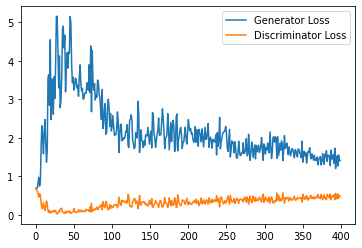

Step 8500: Generator loss: 1.3628907532691956, discriminator loss: 0.4955009309053421


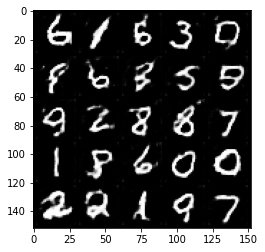

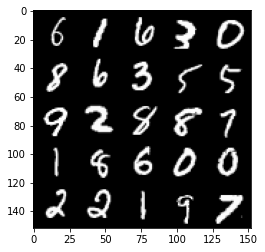

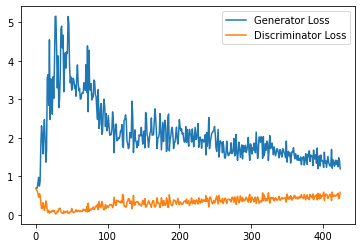

Step 9000: Generator loss: 1.3242329758405686, discriminator loss: 0.5008187563419342


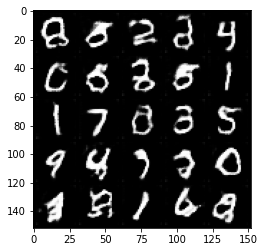

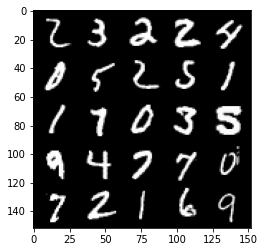

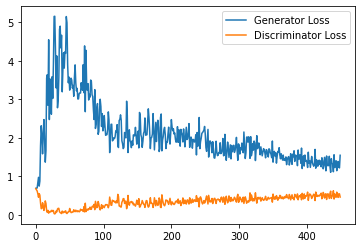

Step 9500: Generator loss: 1.3359121931791305, discriminator loss: 0.5105812744498253


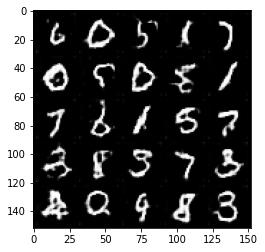

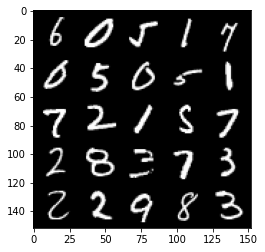

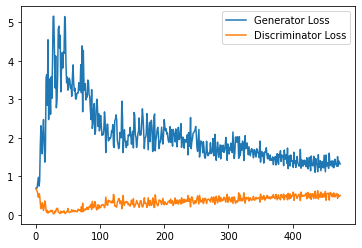

Step 10000: Generator loss: 1.279287808060646, discriminator loss: 0.5172611590027809


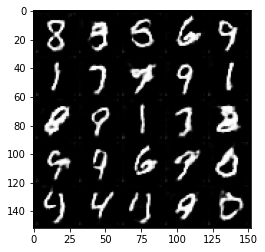

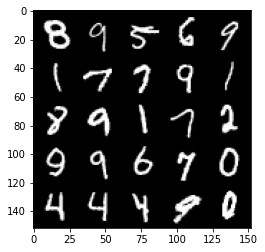

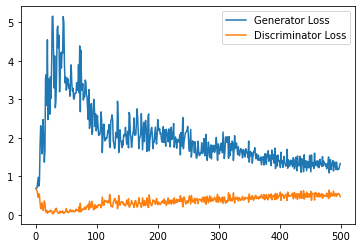

Step 10500: Generator loss: 1.264020541548729, discriminator loss: 0.5224349375963211


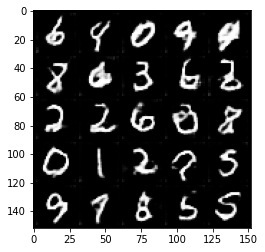

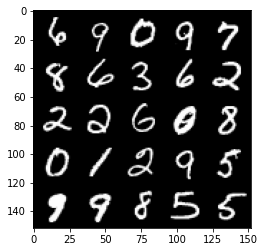

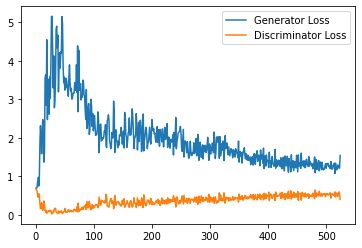

Step 11000: Generator loss: 1.215608601808548, discriminator loss: 0.5410760099887848


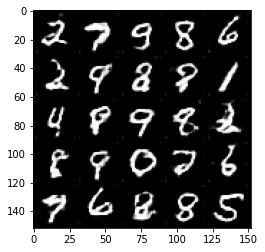

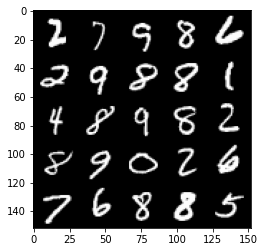

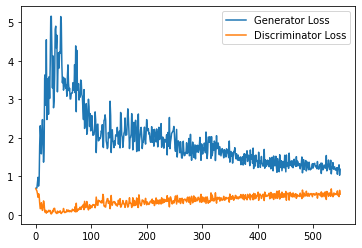

Step 11500: Generator loss: 1.173505848288536, discriminator loss: 0.5457048228979111


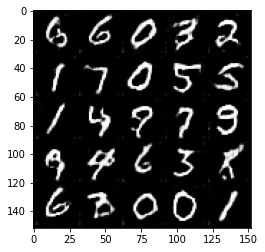

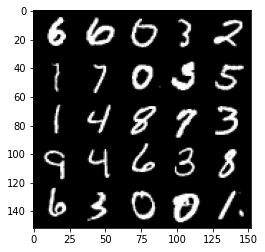

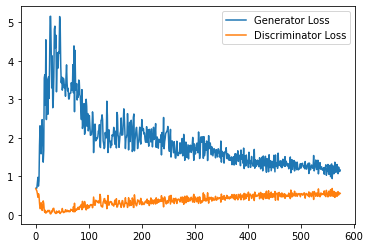

Step 12000: Generator loss: 1.1895245102643968, discriminator loss: 0.5577867000699043


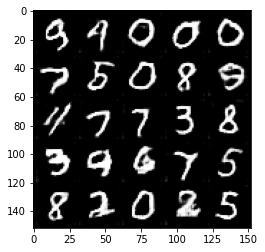

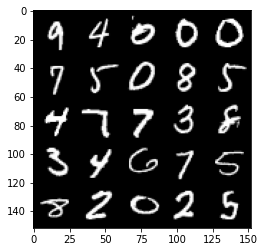

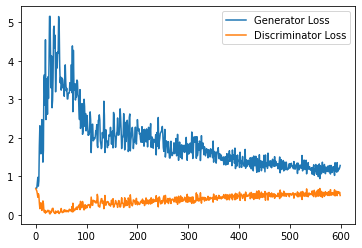

Step 12500: Generator loss: 1.1353914989233016, discriminator loss: 0.5595258900523186


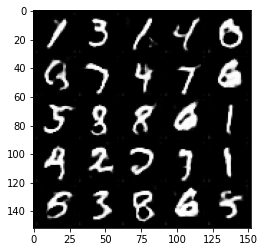

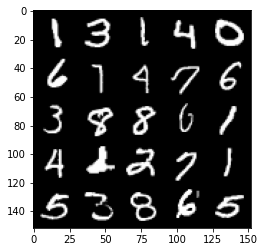

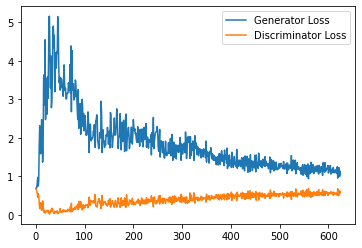

Step 13000: Generator loss: 1.1427656440734864, discriminator loss: 0.5654660072922707


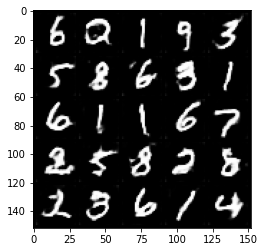

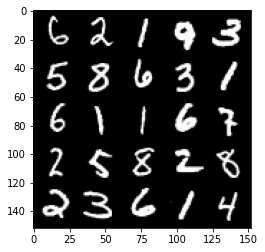

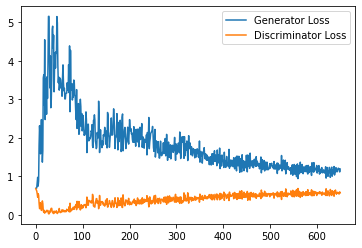

Step 13500: Generator loss: 1.1280505254268647, discriminator loss: 0.5674954632520676


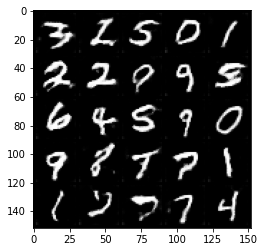

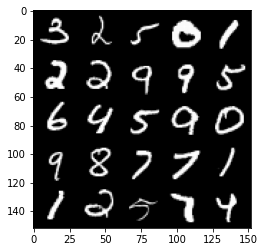

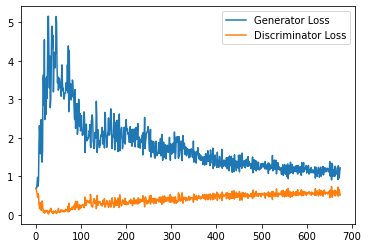

Step 14000: Generator loss: 1.0879367800951003, discriminator loss: 0.5697184058427811


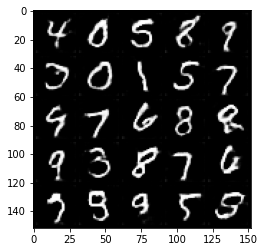

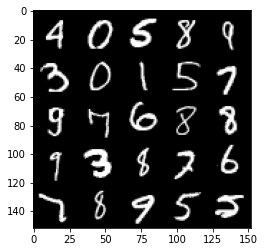

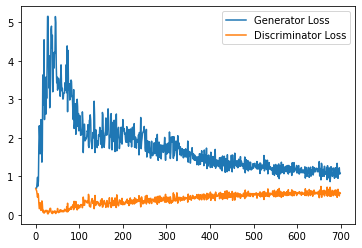

Step 14500: Generator loss: 1.129554124236107, discriminator loss: 0.5697549234628677


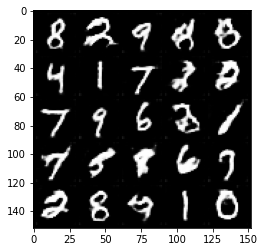

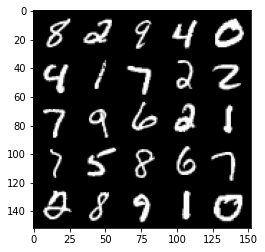

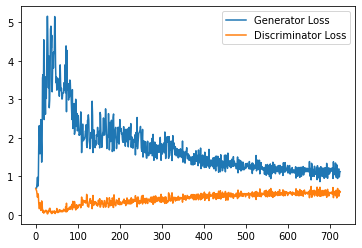

Step 15000: Generator loss: 1.120067179918289, discriminator loss: 0.5646818492412568


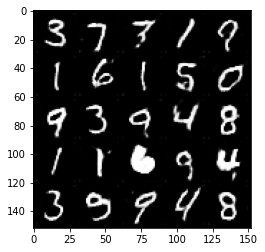

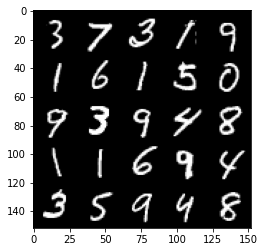

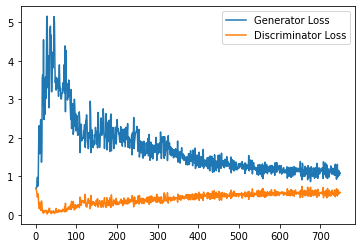

Step 15500: Generator loss: 1.1087765049934388, discriminator loss: 0.575942007124424


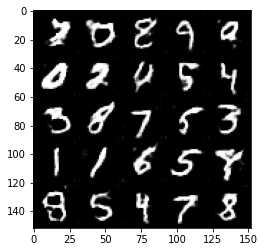

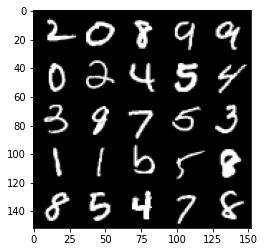

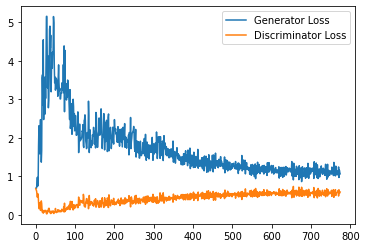

Step 16000: Generator loss: 1.0965449125766755, discriminator loss: 0.5739049472212792


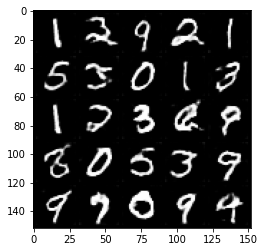

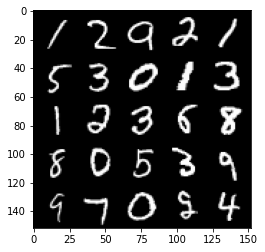

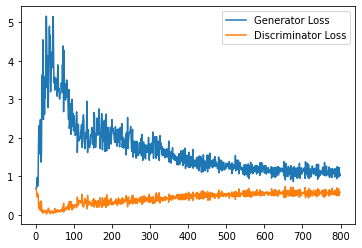

Step 16500: Generator loss: 1.0694197770357132, discriminator loss: 0.5730099225044251


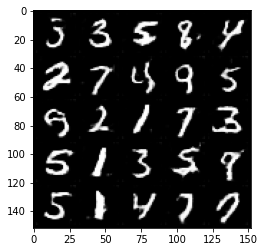

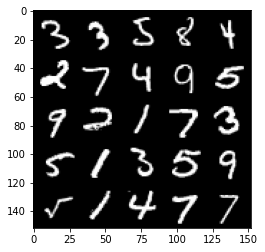

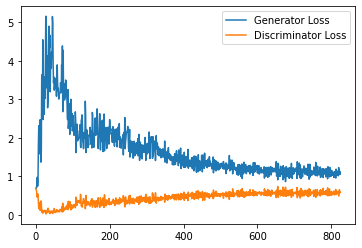

Step 17000: Generator loss: 1.0954982792139054, discriminator loss: 0.579454196870327


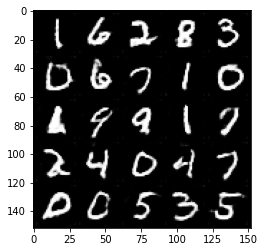

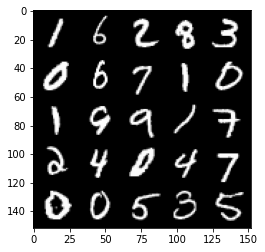

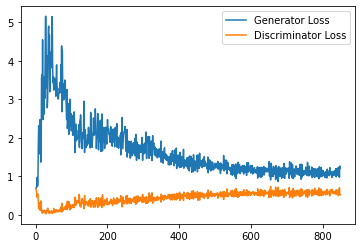

Step 17500: Generator loss: 1.0782639051675798, discriminator loss: 0.5855784976482391


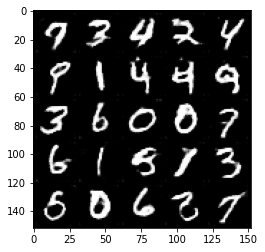

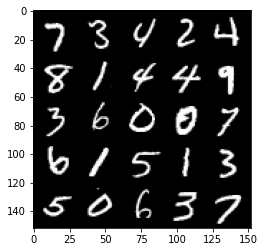

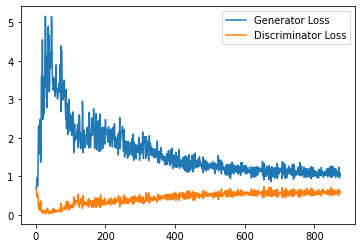

Step 18000: Generator loss: 1.0530541845560073, discriminator loss: 0.5810322927832603


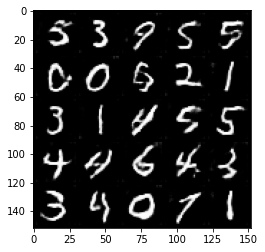

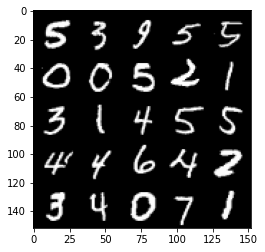

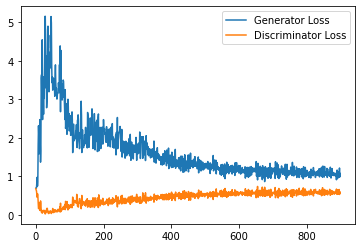

Step 18500: Generator loss: 1.0615347675085067, discriminator loss: 0.5805219649076462


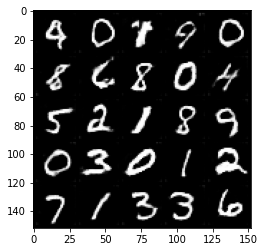

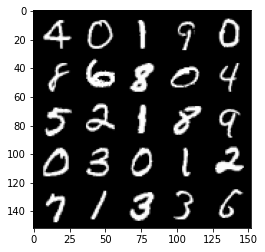

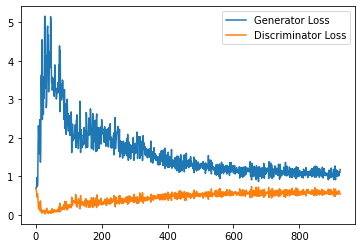

Step 19000: Generator loss: 1.0687070195674897, discriminator loss: 0.582549028813839


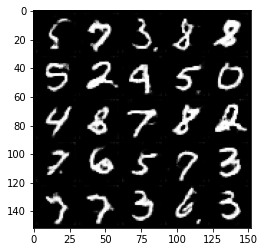

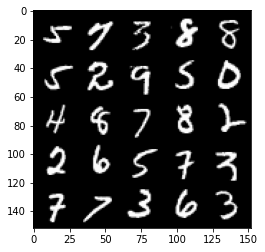

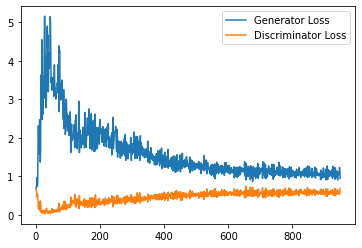

Step 19500: Generator loss: 1.07477590072155, discriminator loss: 0.5781881843209267


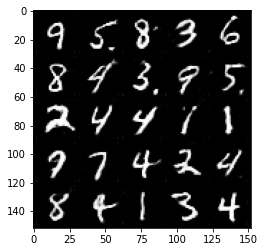

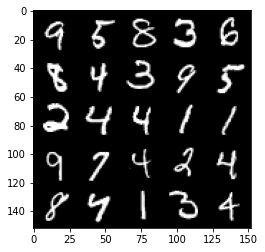

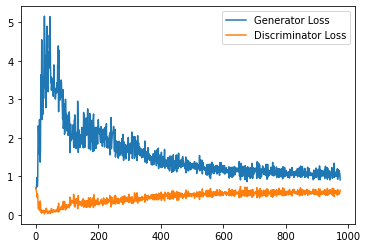

Step 20000: Generator loss: 1.0451227462291717, discriminator loss: 0.5823498463630676


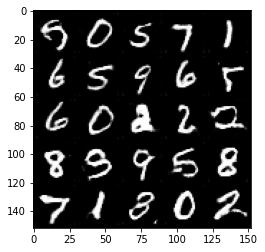

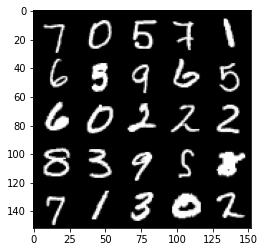

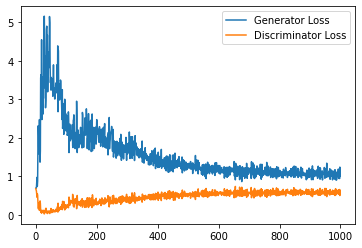

Step 20500: Generator loss: 1.084474624991417, discriminator loss: 0.5744032269120216


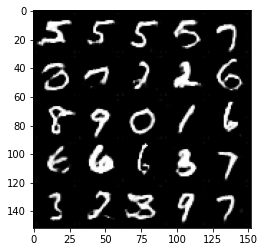

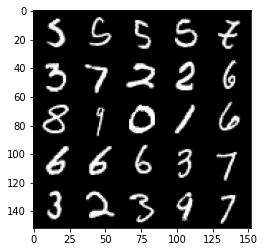

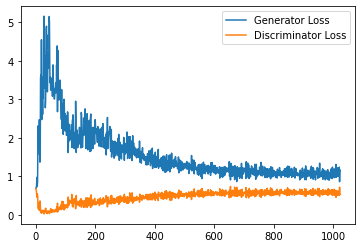

Step 21000: Generator loss: 1.0587394585609435, discriminator loss: 0.5902284440994263


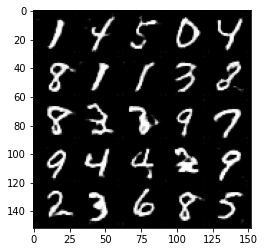

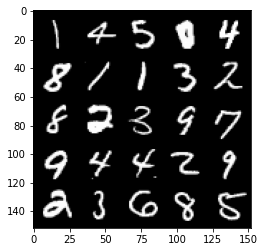

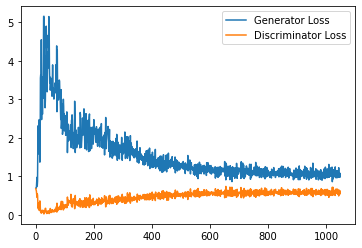

Step 21500: Generator loss: 1.0132698894739152, discriminator loss: 0.5862748875021935


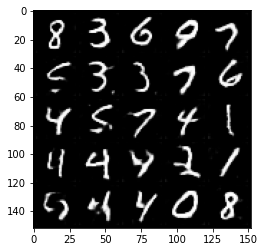

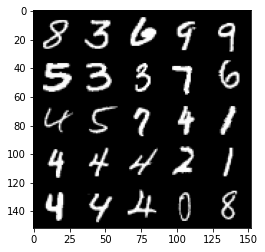

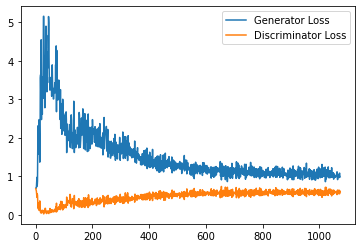

Step 22000: Generator loss: 1.02567553293705, discriminator loss: 0.5874712985754013


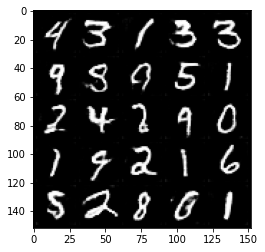

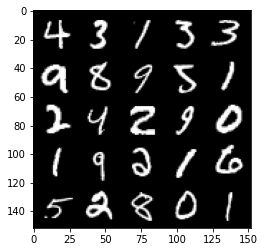

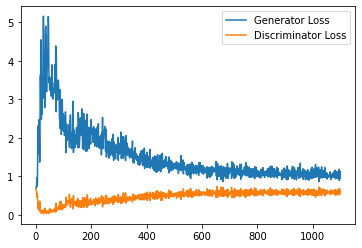

Step 22500: Generator loss: 1.0326663671731948, discriminator loss: 0.5852722751498223


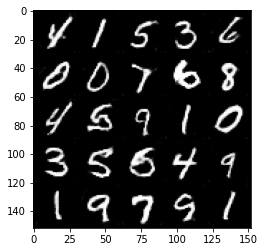

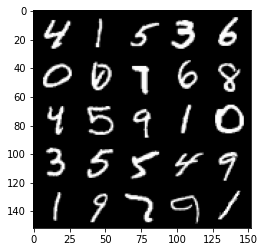

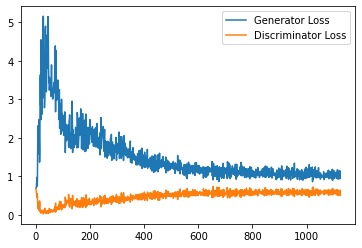

Step 23000: Generator loss: 1.0310286110639573, discriminator loss: 0.5885990997552871


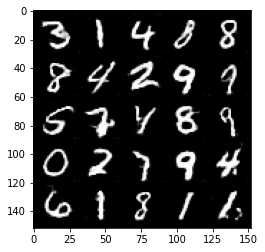

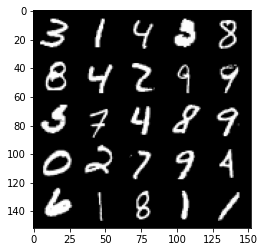

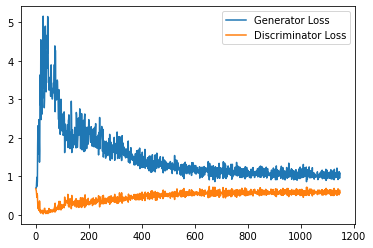

Step 23500: Generator loss: 1.013004635810852, discriminator loss: 0.5895432181358338


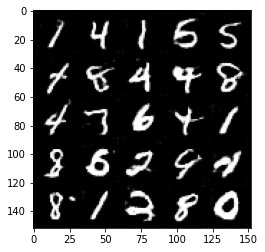

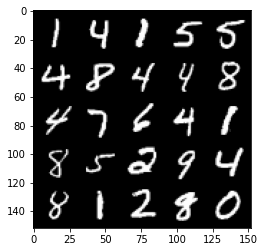

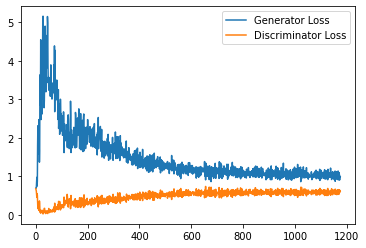

Step 24000: Generator loss: 1.0130783826112748, discriminator loss: 0.5910946378111839


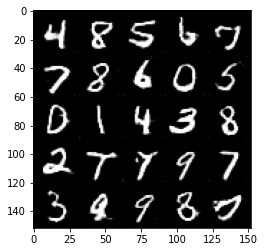

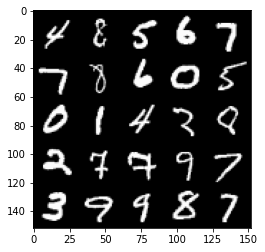

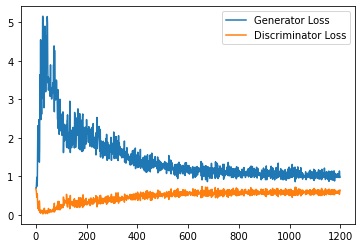

Step 24500: Generator loss: 1.0445480889081955, discriminator loss: 0.5921132498383522


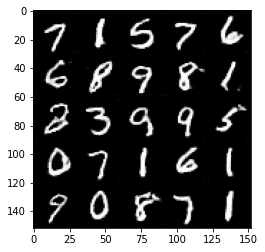

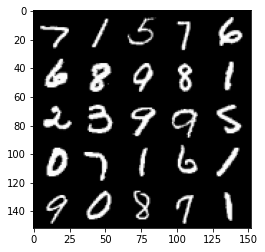

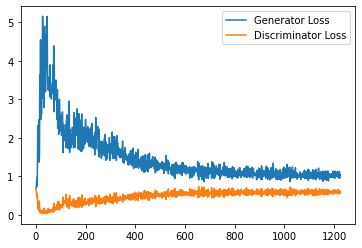

Step 25000: Generator loss: 1.0165564399957656, discriminator loss: 0.5878334626555443


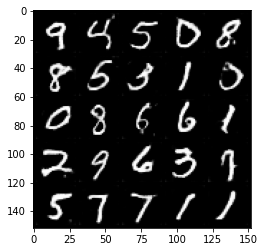

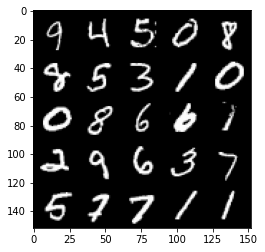

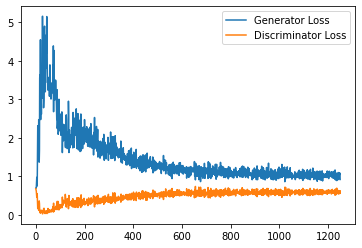

Step 25500: Generator loss: 1.0138589487075806, discriminator loss: 0.5904895285964012


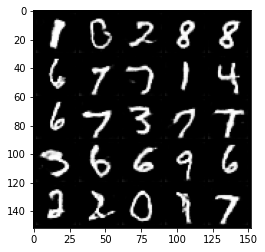

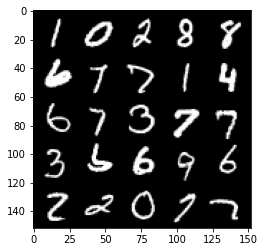

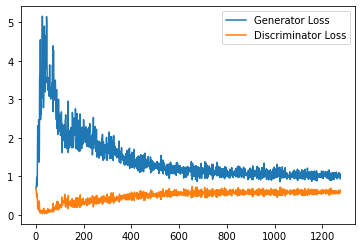

Step 26000: Generator loss: 1.003770712852478, discriminator loss: 0.5892200000286102


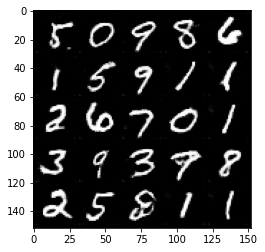

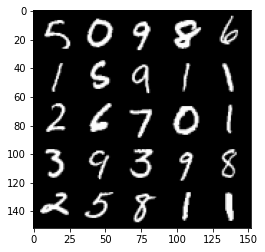

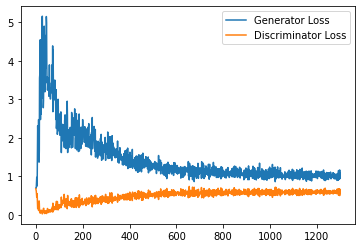

Step 26500: Generator loss: 1.021859258890152, discriminator loss: 0.598080022752285


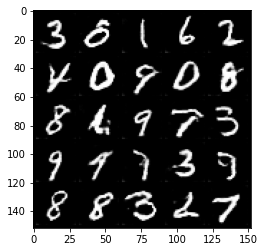

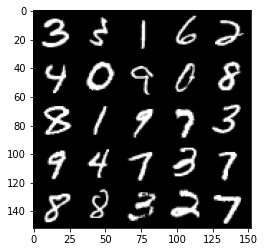

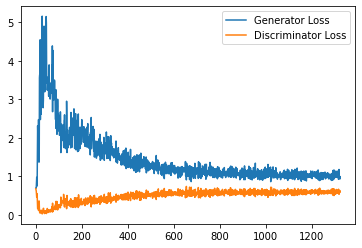

Step 27000: Generator loss: 1.0185930339097977, discriminator loss: 0.5906887425780296


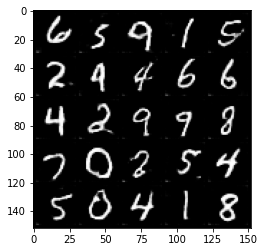

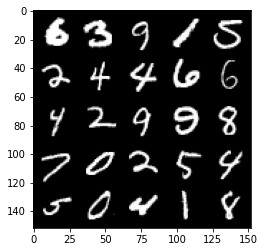

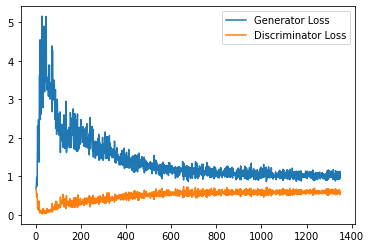

Step 27500: Generator loss: 0.9888267452716828, discriminator loss: 0.5928569250106811


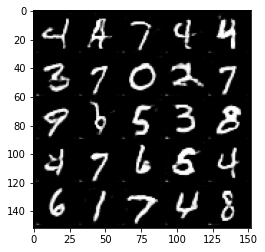

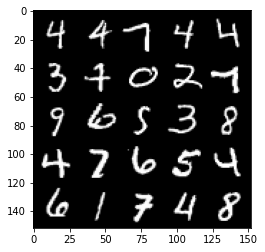

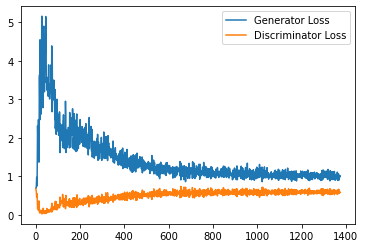

Step 28000: Generator loss: 1.0278530169725417, discriminator loss: 0.5961291037201881


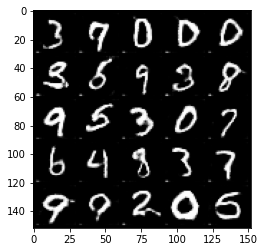

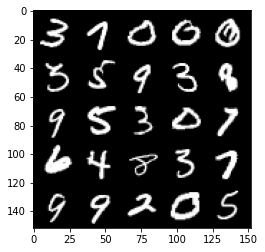

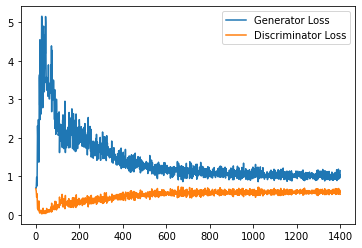

Step 28500: Generator loss: 0.9860669237375259, discriminator loss: 0.5996398671865463


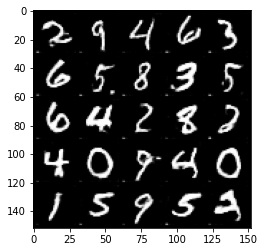

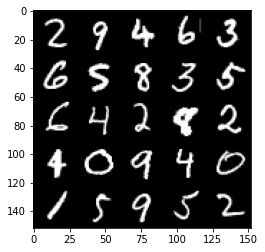

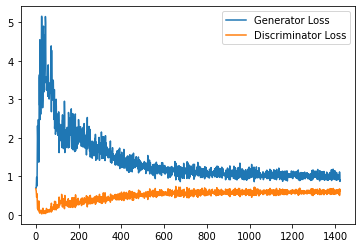

Step 29000: Generator loss: 1.01459097802639, discriminator loss: 0.5907095762491226


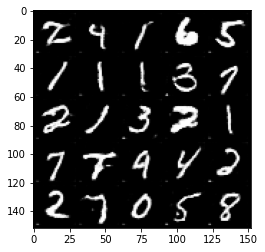

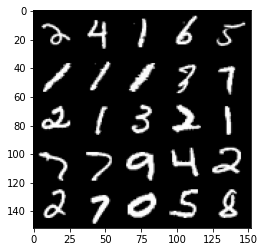

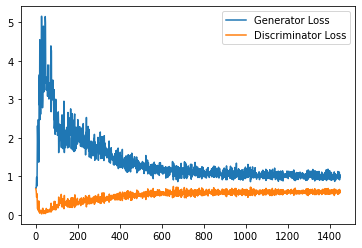

Step 29500: Generator loss: 1.0151492056846618, discriminator loss: 0.5951253165602683


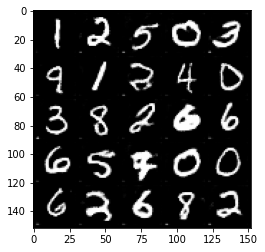

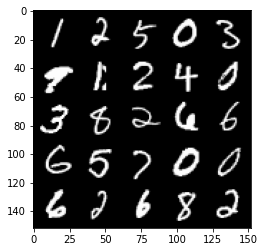

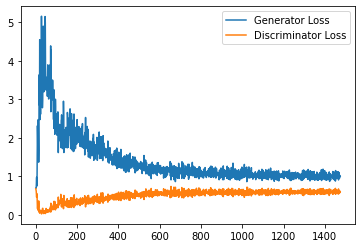

Step 30000: Generator loss: 0.9962043626308441, discriminator loss: 0.5984172569513321


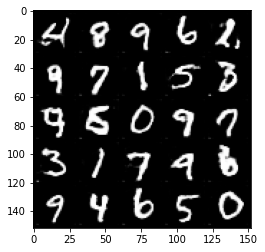

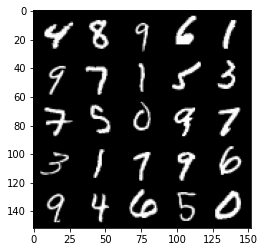

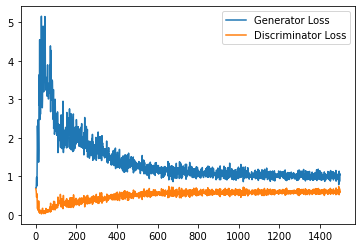

Step 30500: Generator loss: 1.0118159180879593, discriminator loss: 0.5984223191142082


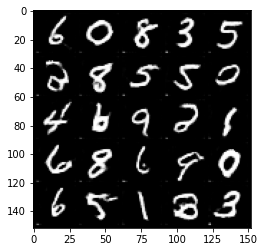

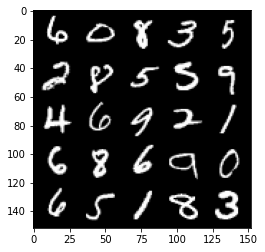

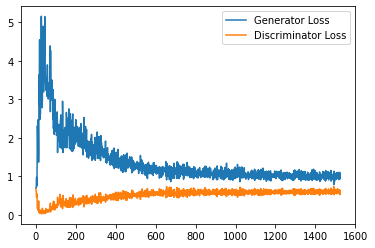

Step 31000: Generator loss: 0.9757253917455673, discriminator loss: 0.5964550523161888


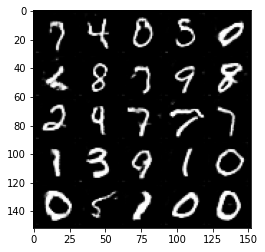

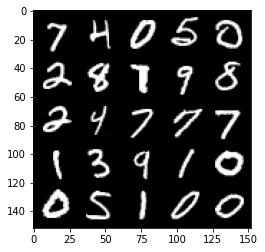

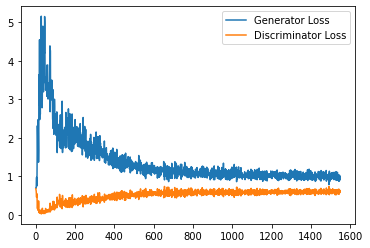

Step 31500: Generator loss: 1.0246906257867814, discriminator loss: 0.6013639927506447


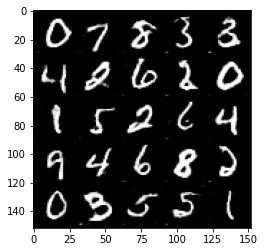

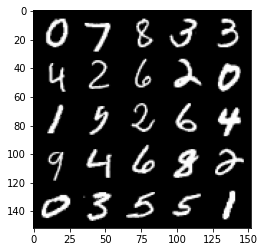

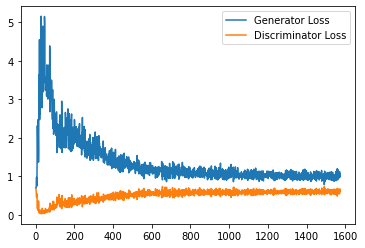

Step 32000: Generator loss: 1.0097168864011765, discriminator loss: 0.5956010969281197


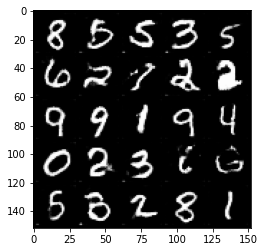

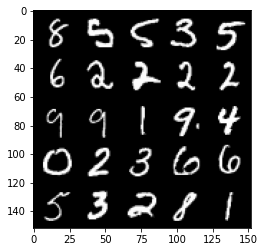

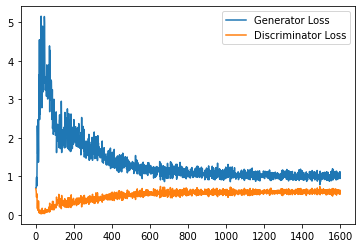

Step 32500: Generator loss: 1.0386037855148316, discriminator loss: 0.6020041845440864


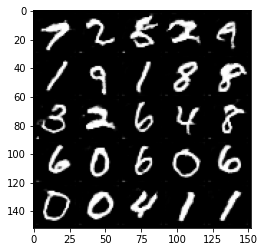

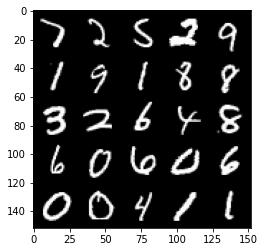

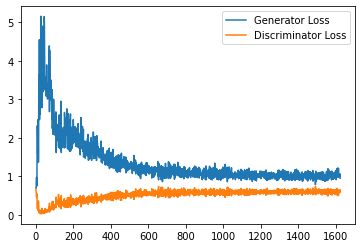

Step 33000: Generator loss: 1.0441681777238845, discriminator loss: 0.5948497526645661


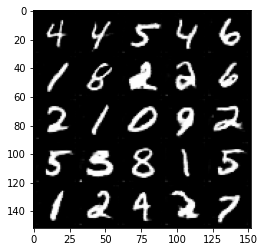

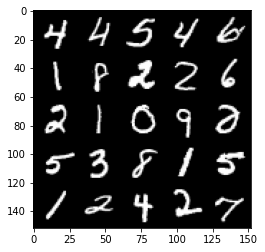

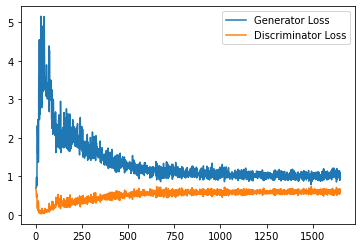

Step 33500: Generator loss: 1.0138018066883088, discriminator loss: 0.598456755578518


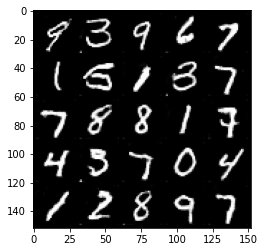

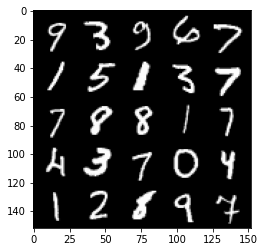

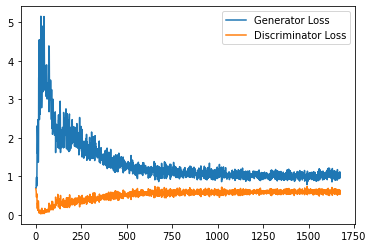

Step 34000: Generator loss: 0.9931876312494278, discriminator loss: 0.596516568005085


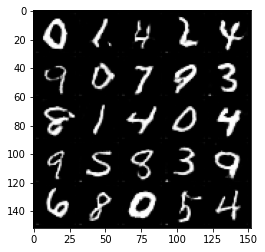

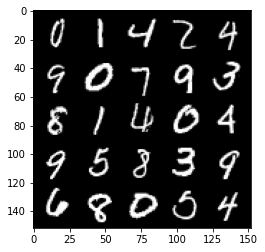

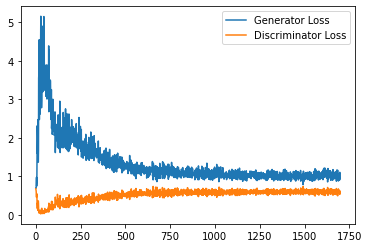

Step 34500: Generator loss: 0.9926358724832535, discriminator loss: 0.5936976461410522


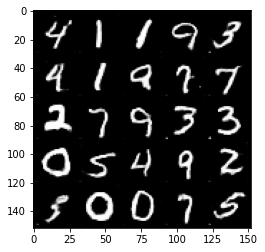

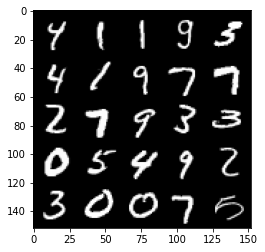

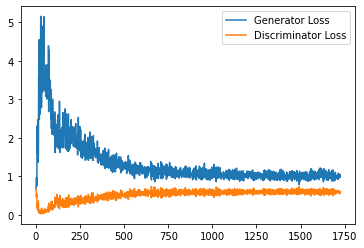

Step 35000: Generator loss: 1.0151763433218002, discriminator loss: 0.5965210065841675


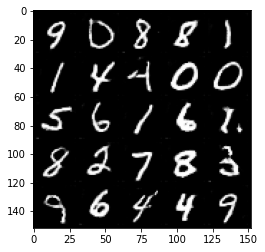

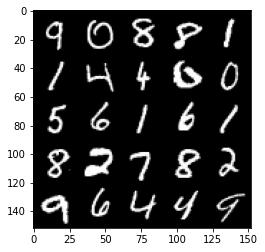

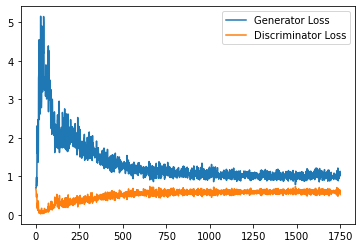

Step 35500: Generator loss: 1.0058198446035385, discriminator loss: 0.5948058790564537


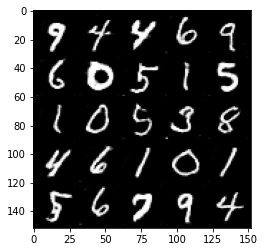

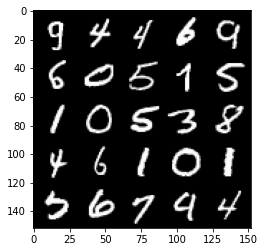

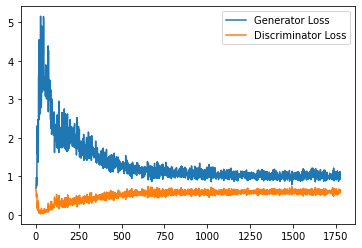

Step 36000: Generator loss: 0.9983430725336074, discriminator loss: 0.5949085956215858


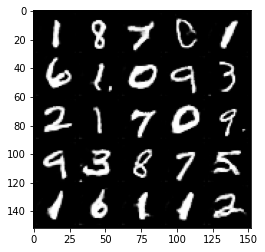

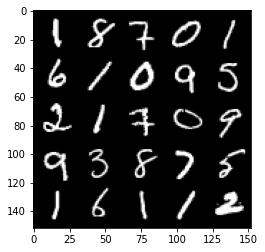

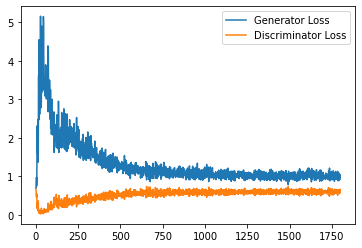

Step 36500: Generator loss: 1.0075574349164962, discriminator loss: 0.5918596723079681


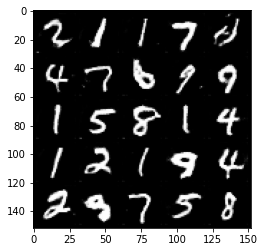

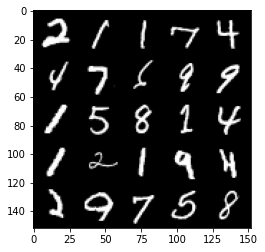

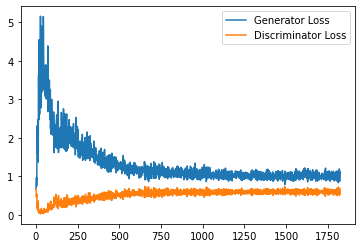

Step 37000: Generator loss: 1.0123351410627366, discriminator loss: 0.5942992316484451


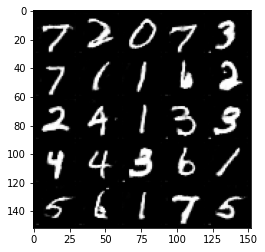

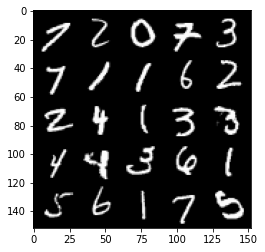

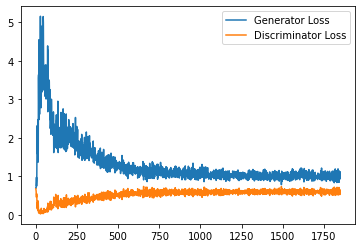

Step 37500: Generator loss: 1.0310101605653763, discriminator loss: 0.5916117423176765


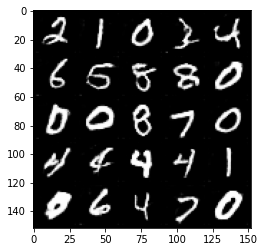

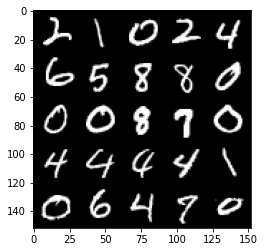

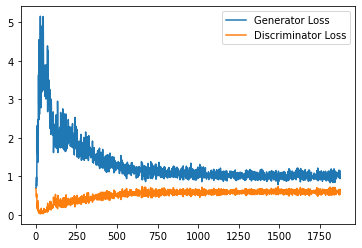

Step 38000: Generator loss: 1.0203145440816879, discriminator loss: 0.5868517099618912


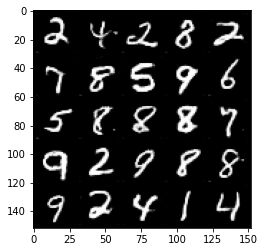

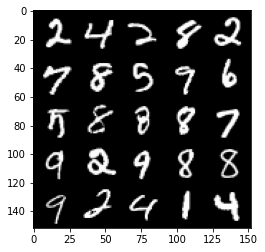

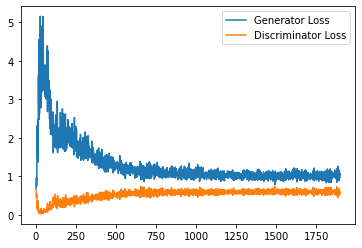

Step 38500: Generator loss: 0.9931740889549255, discriminator loss: 0.5929148475527763


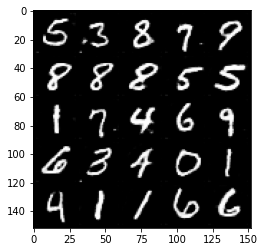

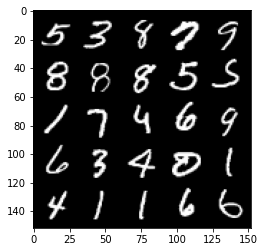

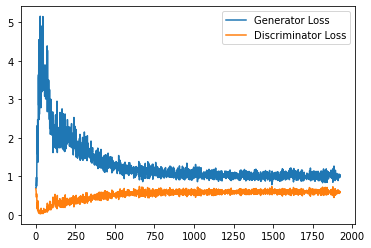

Step 39000: Generator loss: 1.0207094119787217, discriminator loss: 0.5908888475894928


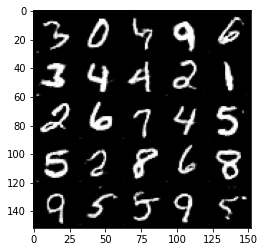

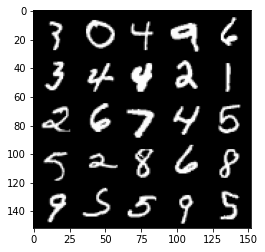

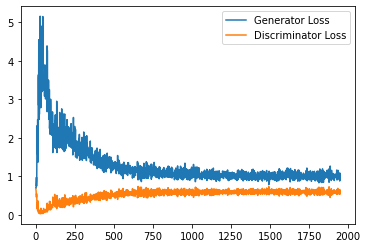

Step 39500: Generator loss: 0.9965361572504043, discriminator loss: 0.5923757795095443


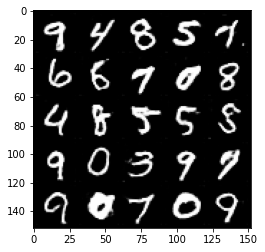

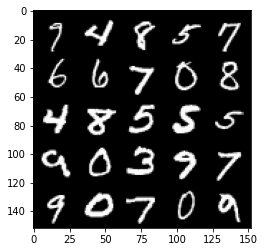

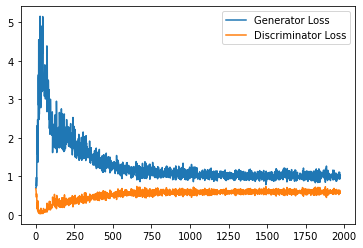

Step 40000: Generator loss: 1.0175595400333404, discriminator loss: 0.590903922021389


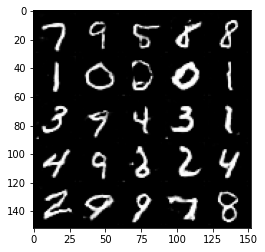

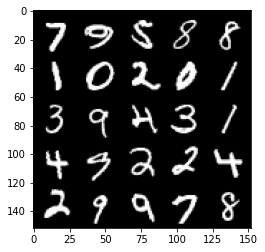

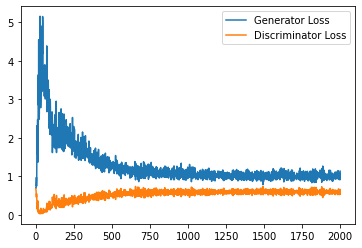

Step 40500: Generator loss: 1.0205003764629363, discriminator loss: 0.5888014528155326


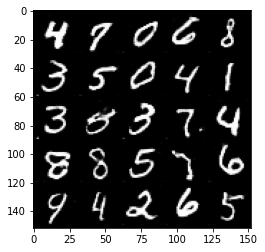

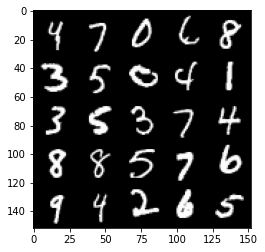

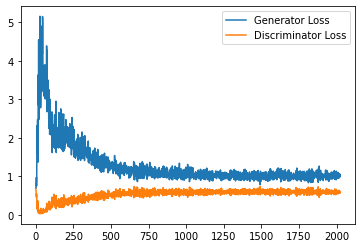

Step 41000: Generator loss: 1.0131166245937346, discriminator loss: 0.5916409801244735


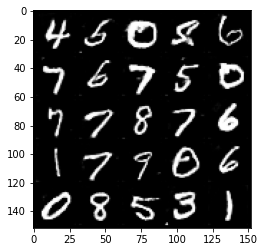

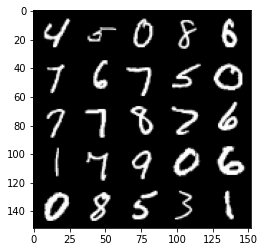

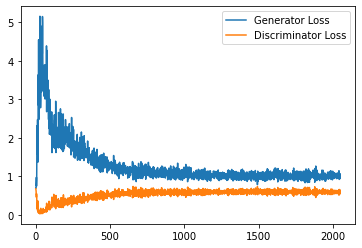

Step 41500: Generator loss: 1.014868591427803, discriminator loss: 0.5941392366886139


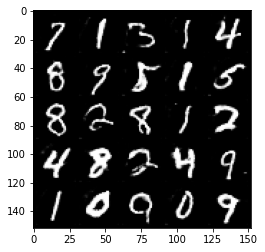

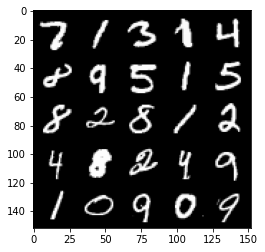

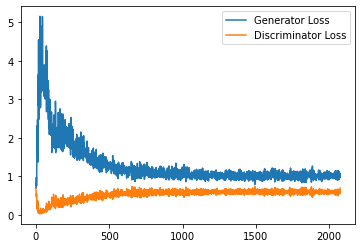

Step 42000: Generator loss: 1.0318031847476958, discriminator loss: 0.5872719298005105


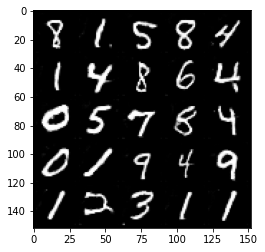

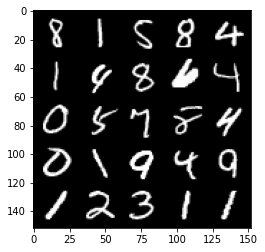

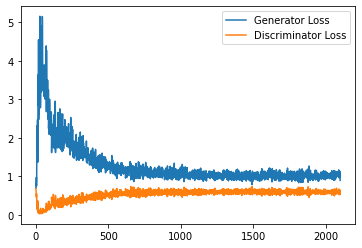

Step 42500: Generator loss: 1.0089797372817992, discriminator loss: 0.589942159473896


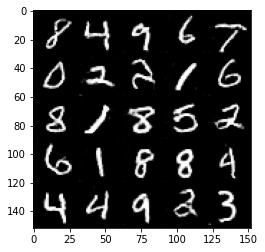

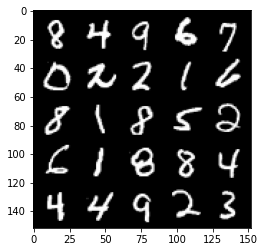

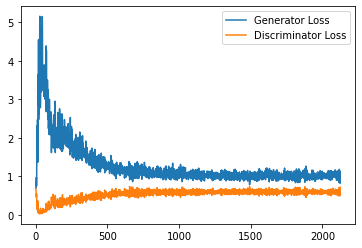

Step 43000: Generator loss: 1.0086620005369187, discriminator loss: 0.5835254545211792


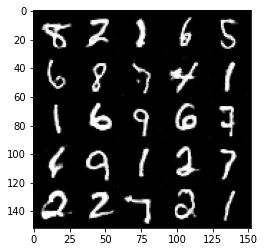

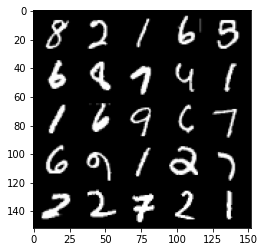

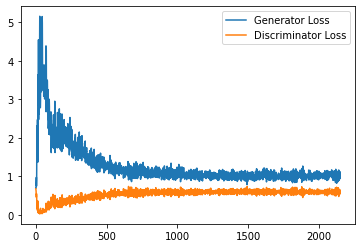

Step 43500: Generator loss: 1.0183631180524826, discriminator loss: 0.5829805017113686


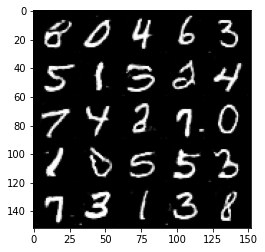

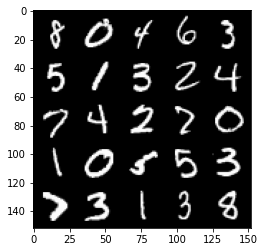

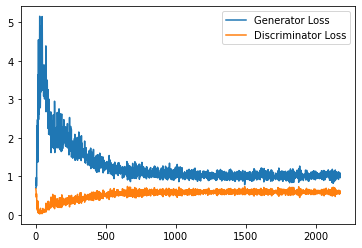

Step 44000: Generator loss: 1.0167724041938782, discriminator loss: 0.5862497938871384


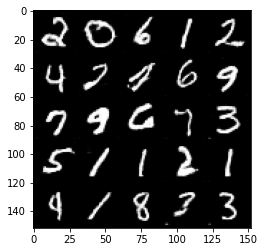

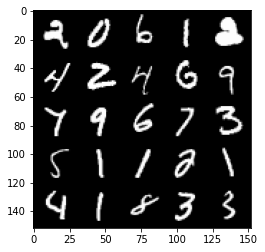

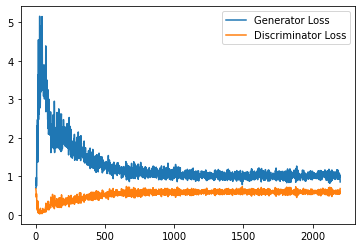

Step 44500: Generator loss: 1.0194591487646103, discriminator loss: 0.5822587996125221


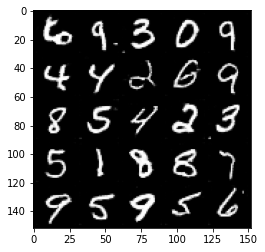

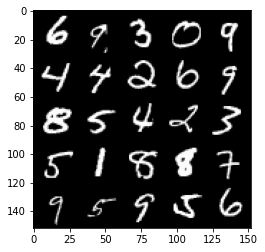

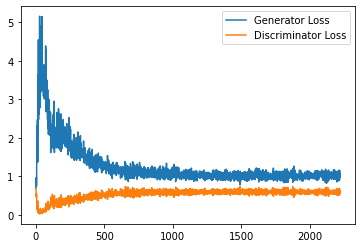

Step 45000: Generator loss: 1.0246634880304337, discriminator loss: 0.5809582920074463


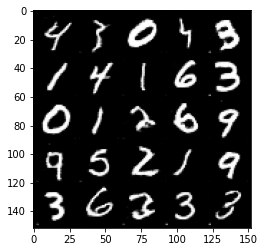

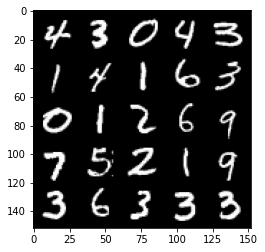

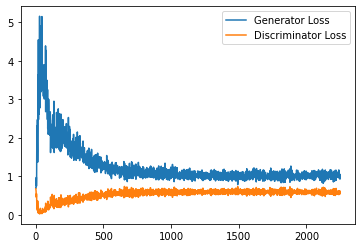

Step 45500: Generator loss: 1.0238451954126357, discriminator loss: 0.5779352031946182


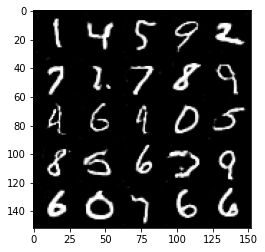

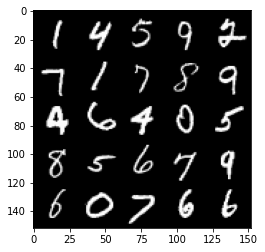

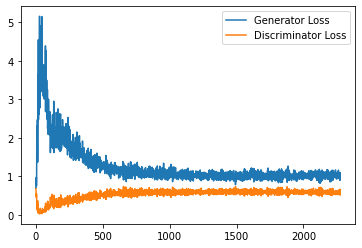

Step 46000: Generator loss: 1.0105182794332503, discriminator loss: 0.5831465999484062


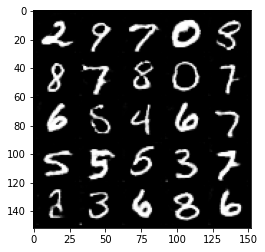

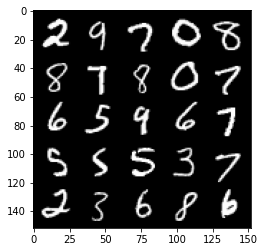

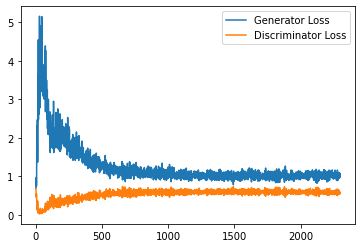

Step 46500: Generator loss: 1.0407192665338516, discriminator loss: 0.5807473316192627


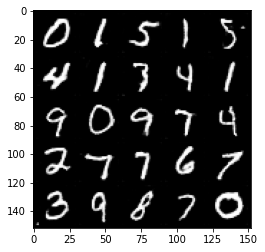

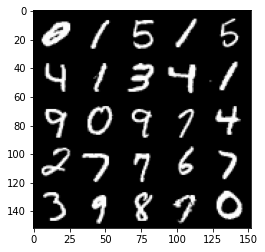

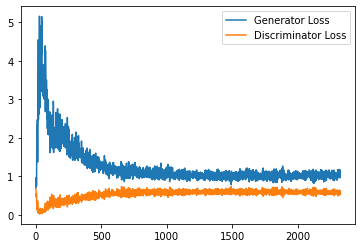

Step 47000: Generator loss: 1.03729827272892, discriminator loss: 0.581903713285923


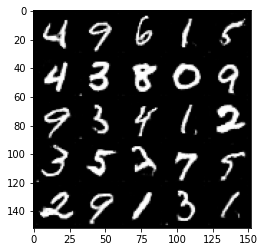

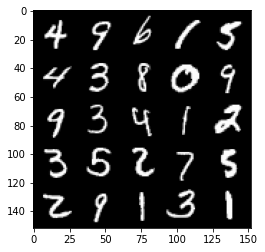

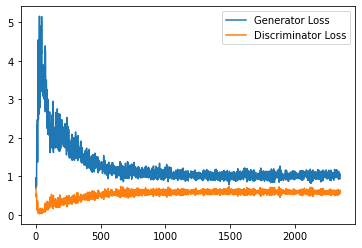

Step 47500: Generator loss: 1.0336296513080596, discriminator loss: 0.5767197571396828


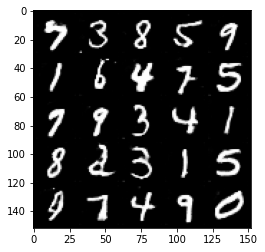

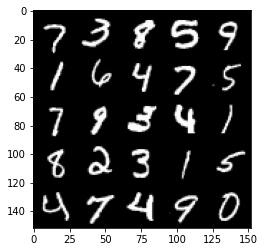

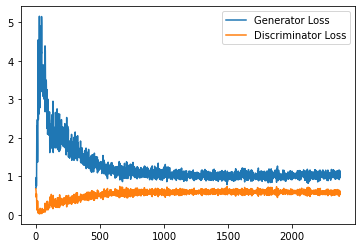

Step 48000: Generator loss: 1.02139815223217, discriminator loss: 0.5781966083049774


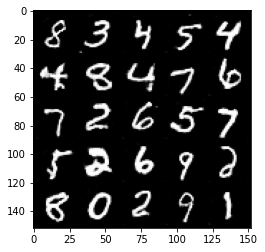

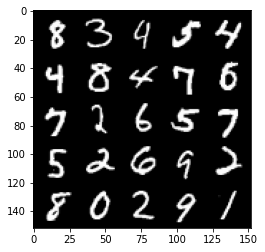

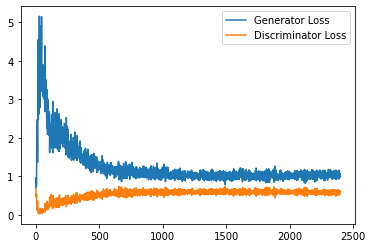

Step 48500: Generator loss: 1.044861724972725, discriminator loss: 0.5756789417862892


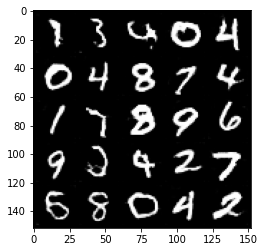

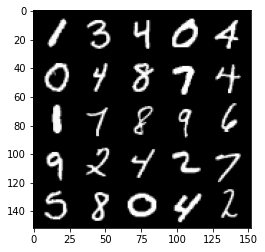

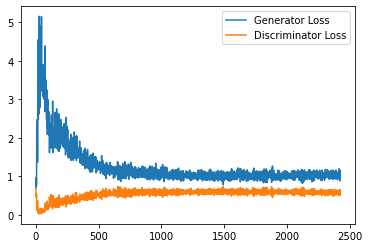

Step 49000: Generator loss: 1.0435754717588426, discriminator loss: 0.5771701800227165


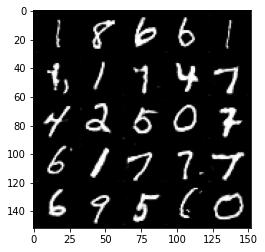

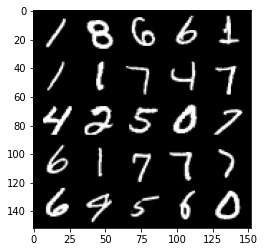

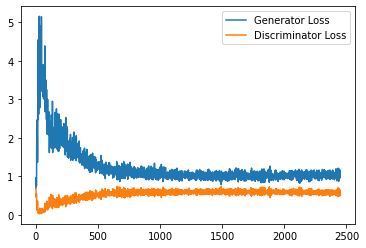

Step 49500: Generator loss: 1.0311262654066087, discriminator loss: 0.5743179543614387


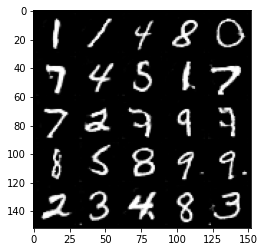

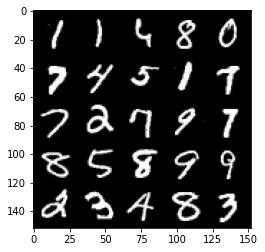

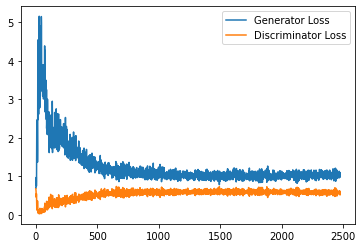

Step 50000: Generator loss: 1.0440034945011138, discriminator loss: 0.5745828125476837


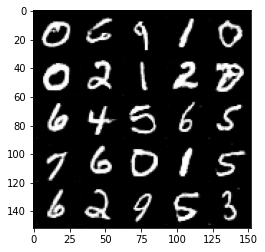

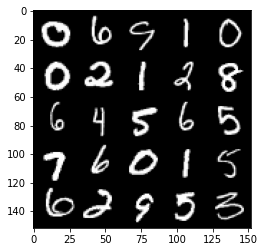

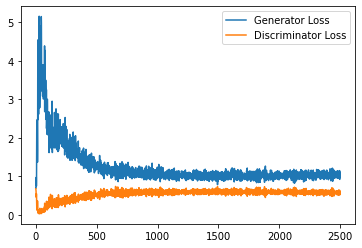

Step 50500: Generator loss: 1.0362405089139939, discriminator loss: 0.5722455037236214


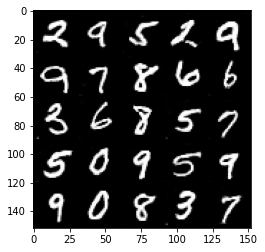

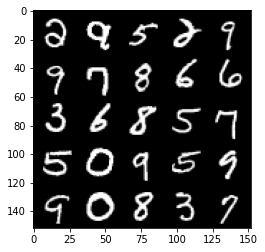

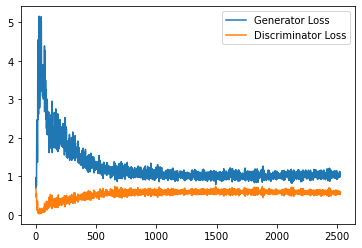

Step 51000: Generator loss: 1.037629119157791, discriminator loss: 0.5689162078499794


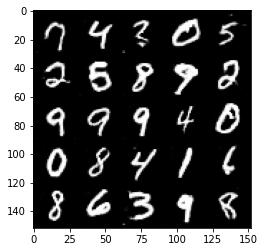

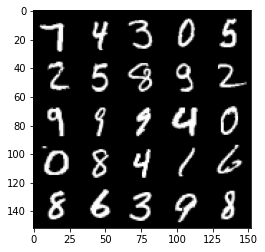

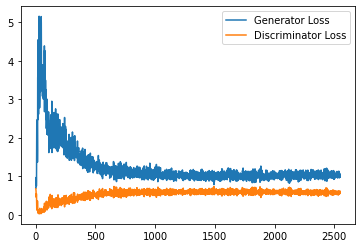

Step 51500: Generator loss: 1.0476870161294938, discriminator loss: 0.568356190443039


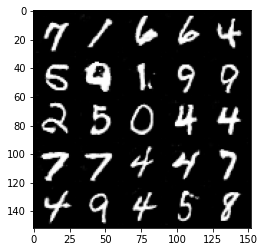

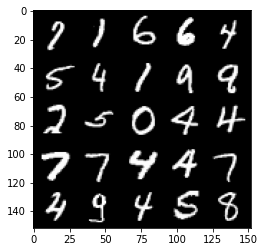

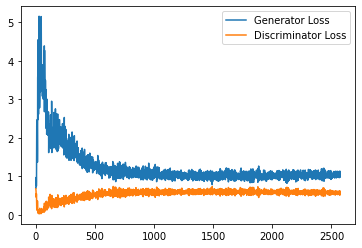

Step 52000: Generator loss: 1.0719665130376816, discriminator loss: 0.567638366997242


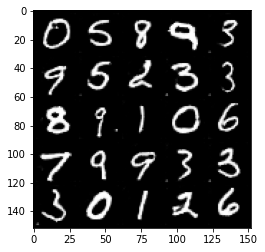

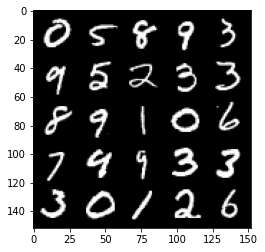

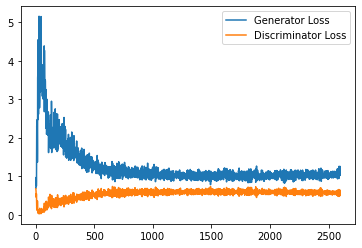

Step 52500: Generator loss: 1.055030502796173, discriminator loss: 0.5654501623511314


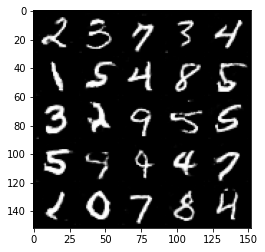

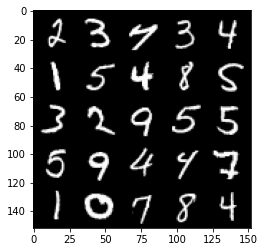

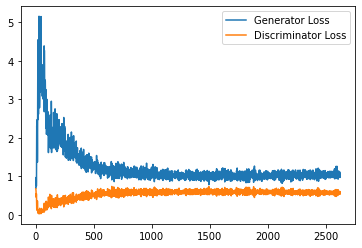

Step 53000: Generator loss: 1.0453176411390304, discriminator loss: 0.5661675589680671


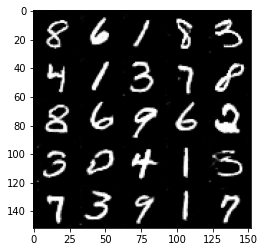

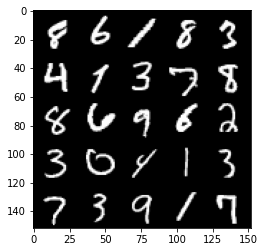

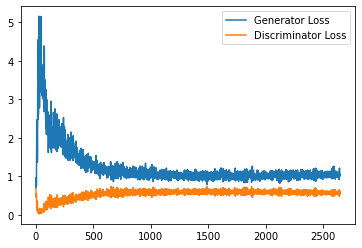

Step 53500: Generator loss: 1.0608534953594209, discriminator loss: 0.5656337158679963


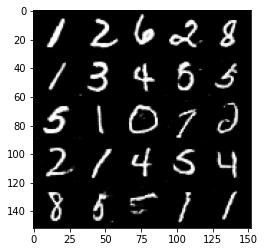

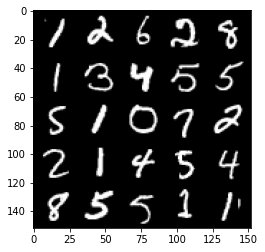

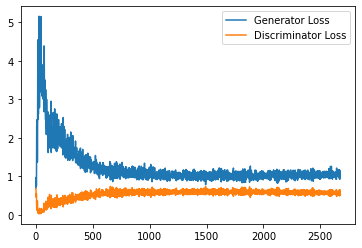

Step 54000: Generator loss: 1.0601244930028915, discriminator loss: 0.5630429393053055


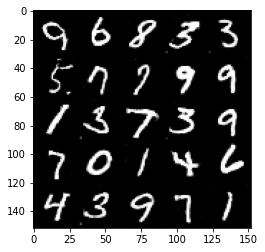

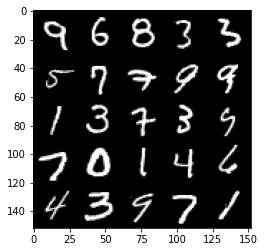

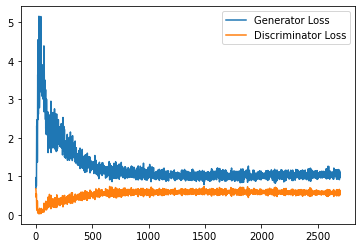

Step 54500: Generator loss: 1.0748322923183442, discriminator loss: 0.5608211245536804


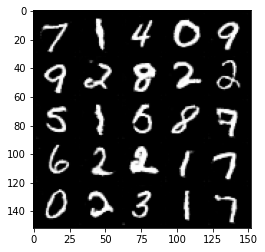

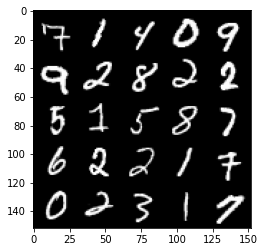

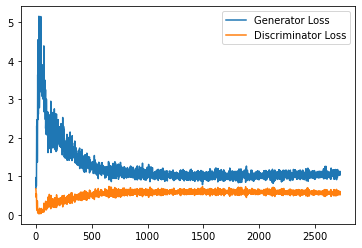

Step 55000: Generator loss: 1.0736868258714676, discriminator loss: 0.5605722191333771


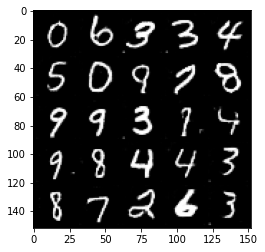

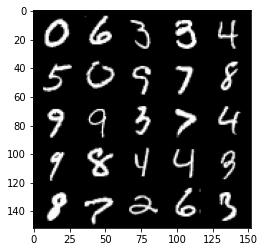

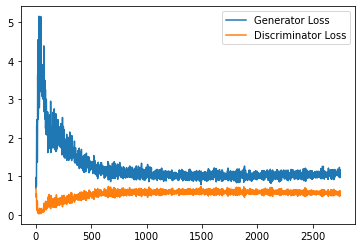

Step 55500: Generator loss: 1.0695421476364135, discriminator loss: 0.5611967964172363


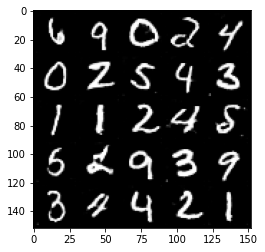

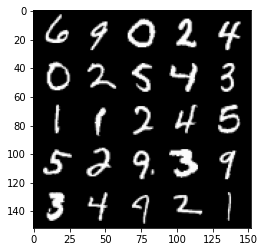

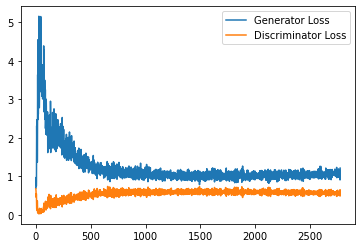

Step 56000: Generator loss: 1.0902854830026627, discriminator loss: 0.5597944319248199


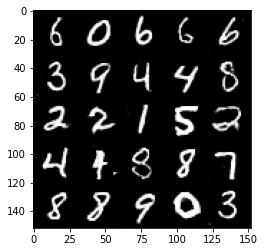

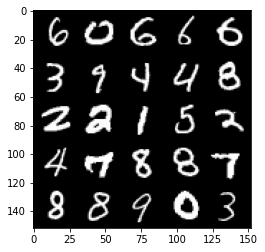

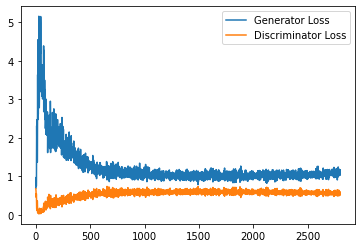

Step 56500: Generator loss: 1.088236939549446, discriminator loss: 0.5628573385477066


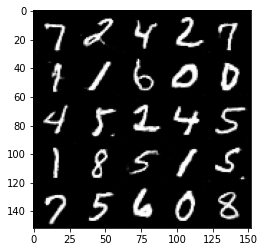

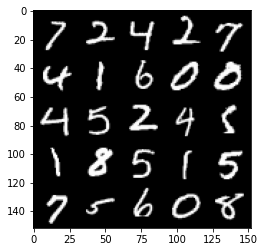

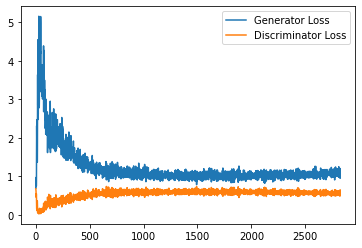

Step 57000: Generator loss: 1.0849527153968812, discriminator loss: 0.5587576758265496


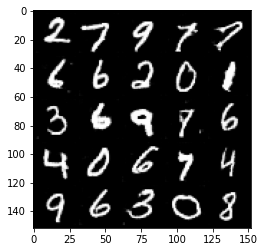

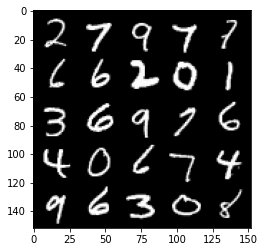

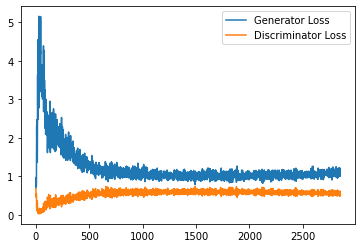

Step 57500: Generator loss: 1.090247039437294, discriminator loss: 0.5513984739780426


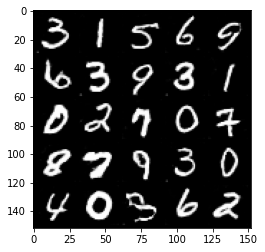

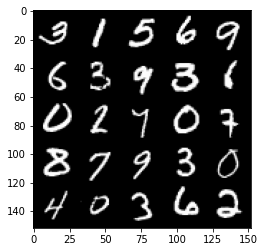

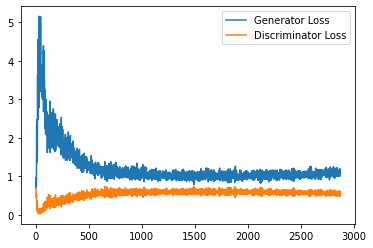

Step 58000: Generator loss: 1.0833172320127487, discriminator loss: 0.5589725799560546


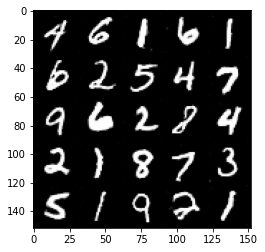

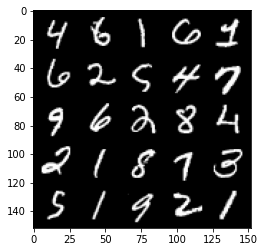

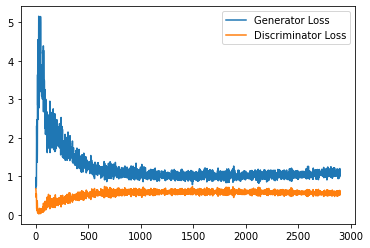

Step 58500: Generator loss: 1.0831724803447724, discriminator loss: 0.5589044361114502


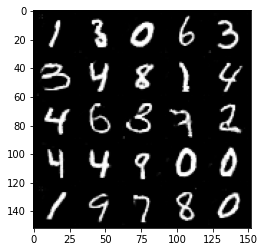

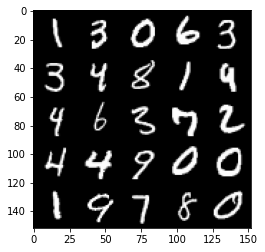

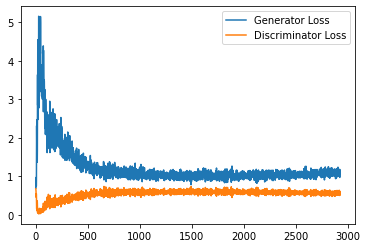

Step 59000: Generator loss: 1.0887513829469682, discriminator loss: 0.5586446365714073


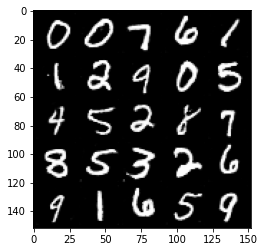

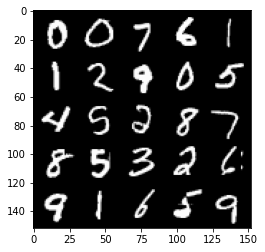

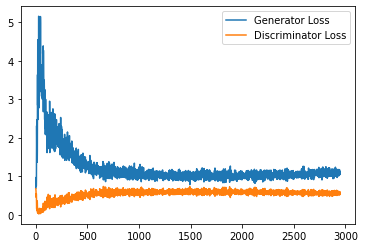

Step 59500: Generator loss: 1.0800829402208327, discriminator loss: 0.558273185968399


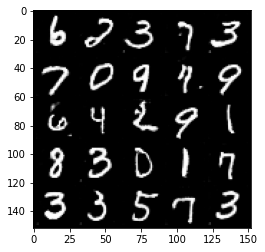

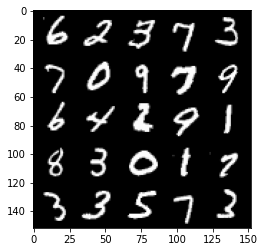

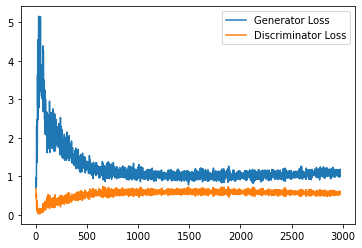

Step 60000: Generator loss: 1.0886048216819764, discriminator loss: 0.5554642069935799


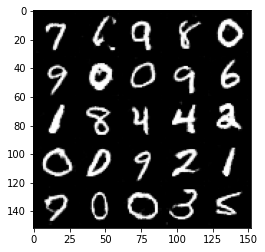

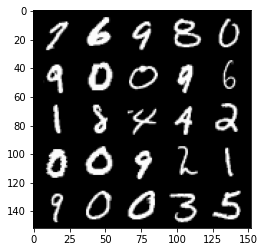

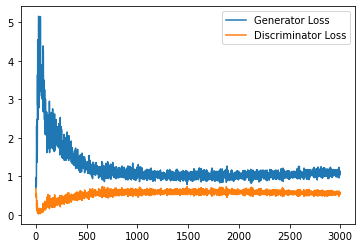

Step 60500: Generator loss: 1.1017340364456176, discriminator loss: 0.5592318480014801


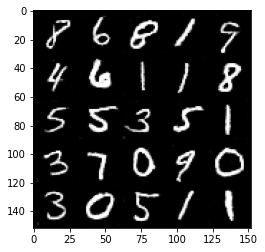

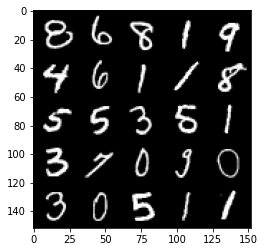

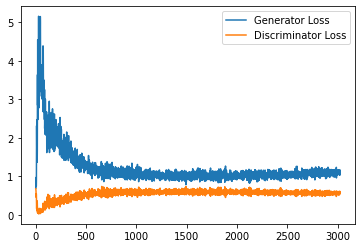

Step 61000: Generator loss: 1.0892575513124465, discriminator loss: 0.5487970578670501


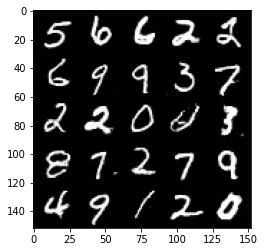

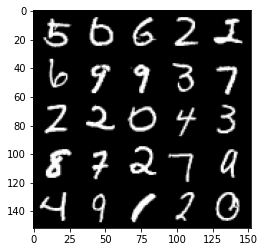

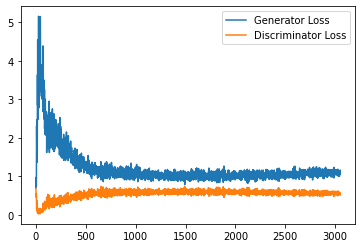

Step 61500: Generator loss: 1.1040734983682632, discriminator loss: 0.556690588593483


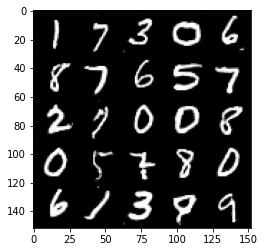

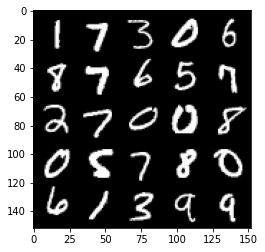

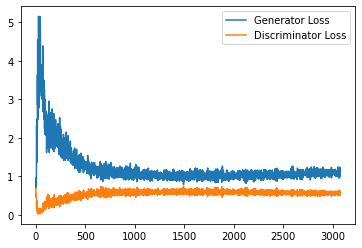

Step 62000: Generator loss: 1.0976049073934555, discriminator loss: 0.5538870016336441


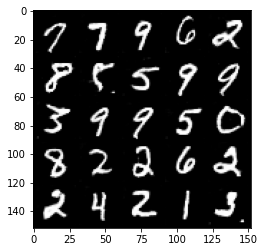

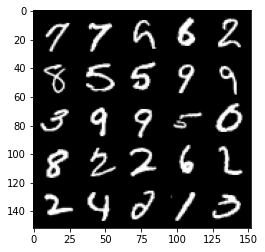

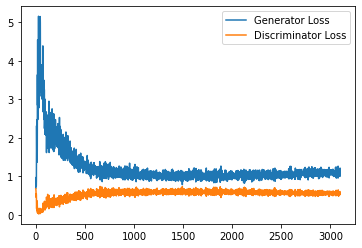

Step 62500: Generator loss: 1.0898372250795365, discriminator loss: 0.5552493076920509


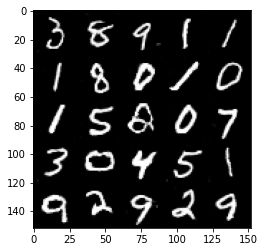

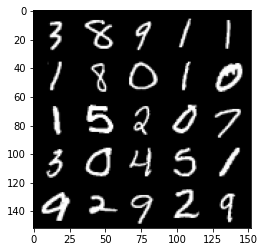

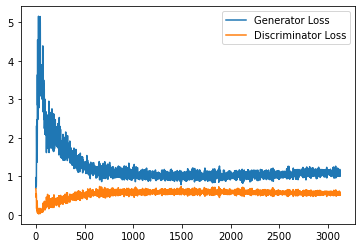

Step 63000: Generator loss: 1.0842176797389984, discriminator loss: 0.5568124589920044


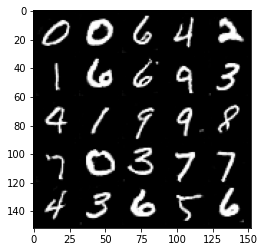

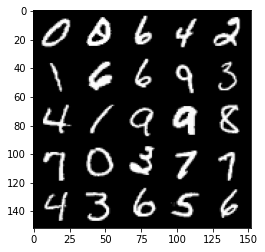

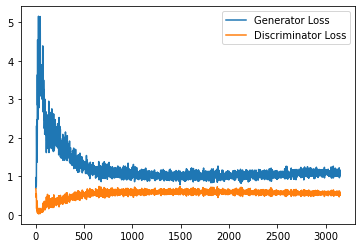

Step 63500: Generator loss: 1.0913366693258286, discriminator loss: 0.553222770512104


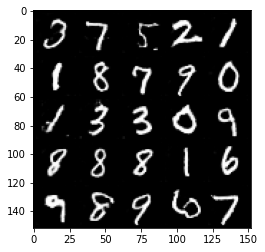

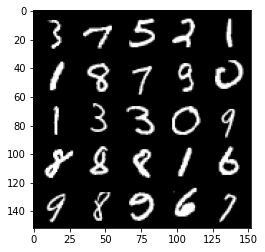

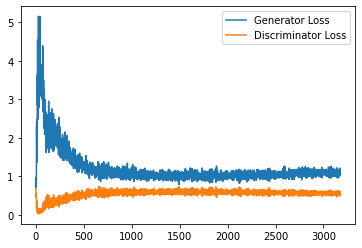

Step 64000: Generator loss: 1.1038398418426514, discriminator loss: 0.5495678731799125


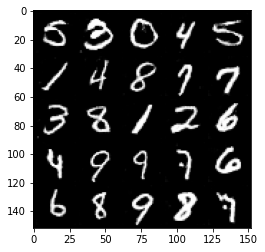

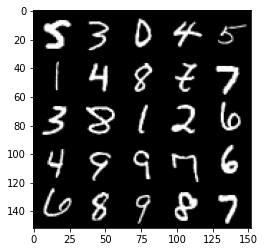

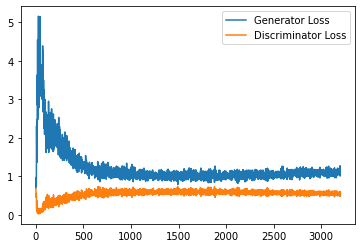

Step 64500: Generator loss: 1.1061645420789719, discriminator loss: 0.5529110971093177


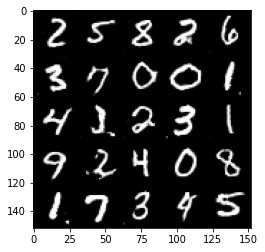

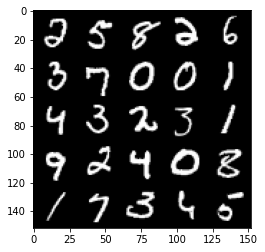

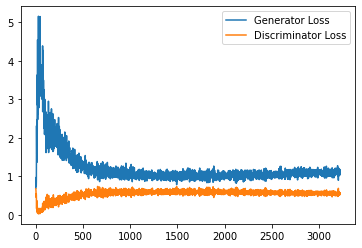

Step 65000: Generator loss: 1.0901415652036668, discriminator loss: 0.5510489981174469


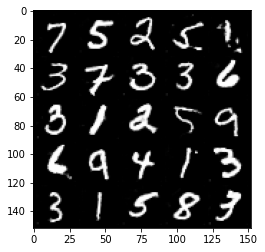

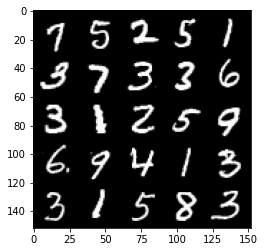

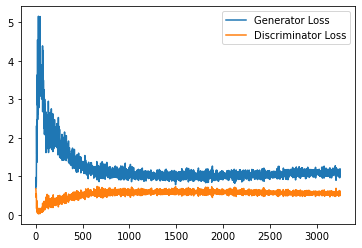

Step 65500: Generator loss: 1.1195439920425414, discriminator loss: 0.5498211092352867


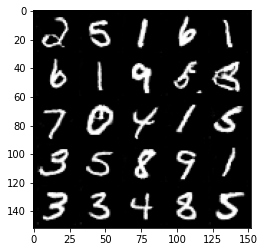

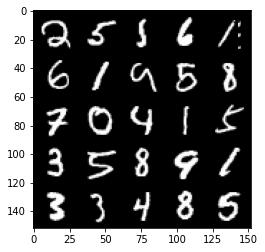

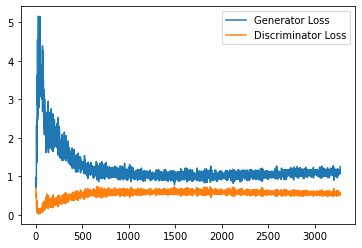

Step 66000: Generator loss: 1.1071421523094178, discriminator loss: 0.558514707326889


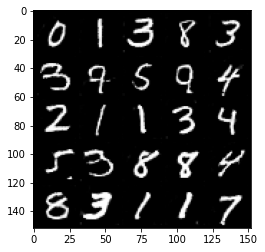

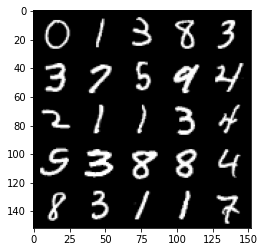

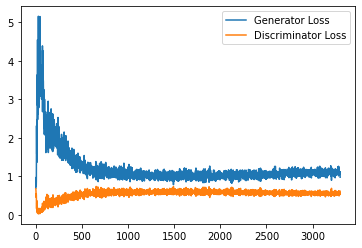

Step 66500: Generator loss: 1.1058800226449967, discriminator loss: 0.5466640457510948


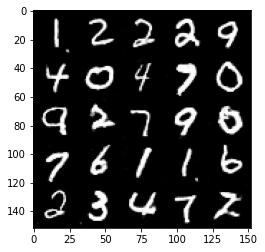

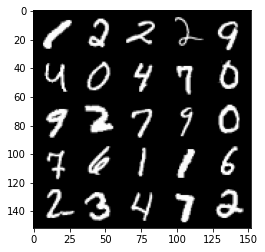

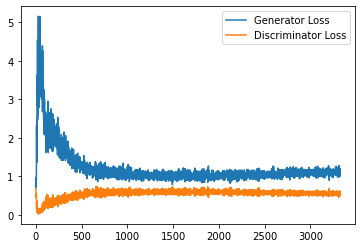

Step 67000: Generator loss: 1.1191728520393371, discriminator loss: 0.5546021991372109


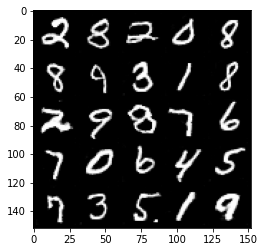

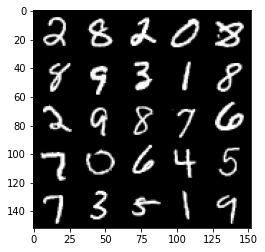

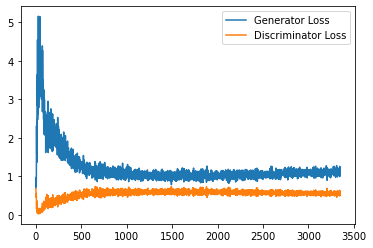

Step 67500: Generator loss: 1.1077377268075943, discriminator loss: 0.5489621565937995


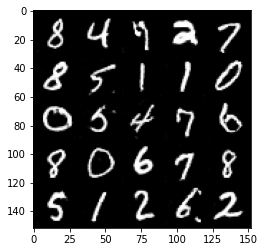

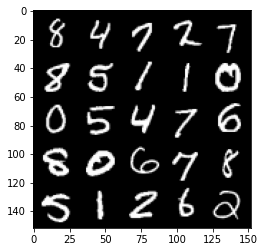

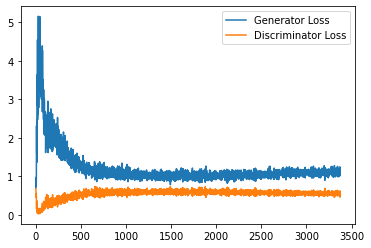

Step 68000: Generator loss: 1.1191703966856004, discriminator loss: 0.5494570177793503


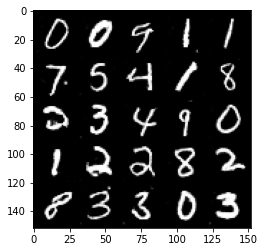

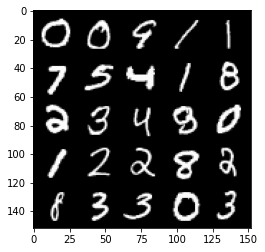

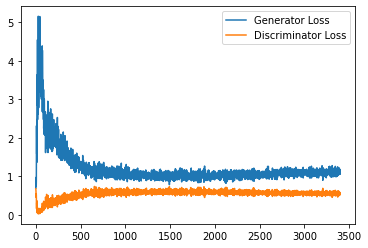

Step 68500: Generator loss: 1.1088054113388062, discriminator loss: 0.5492822424769401


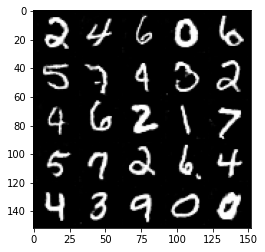

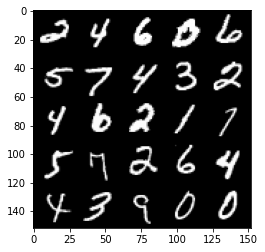

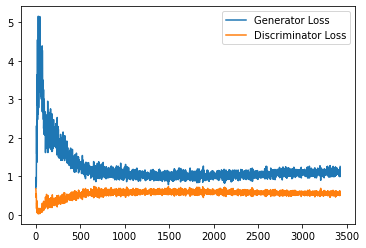

Step 69000: Generator loss: 1.1175720864534378, discriminator loss: 0.5465117942690849


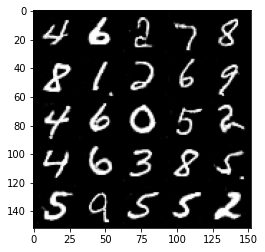

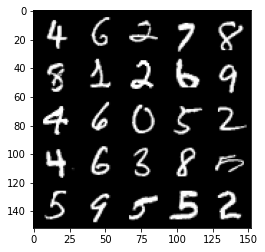

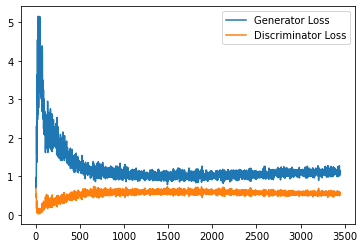

Step 69500: Generator loss: 1.1143380811214447, discriminator loss: 0.5476623029708863


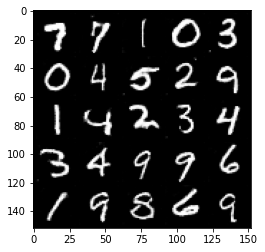

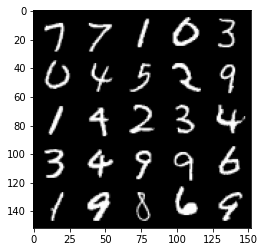

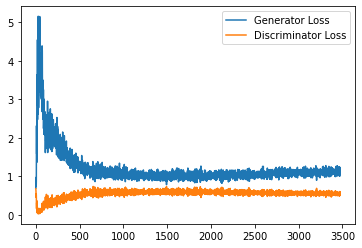

Step 70000: Generator loss: 1.1217360134124756, discriminator loss: 0.5493900244235992


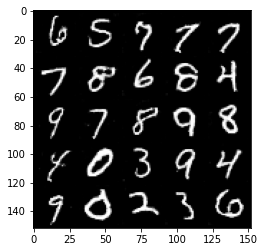

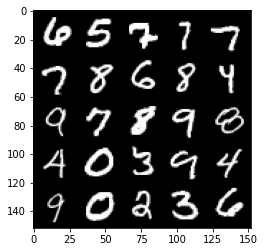

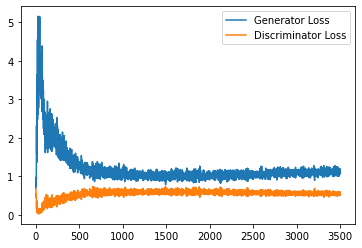

Step 70500: Generator loss: 1.1127466294765473, discriminator loss: 0.5528722141385078


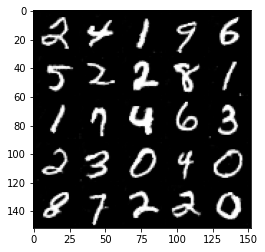

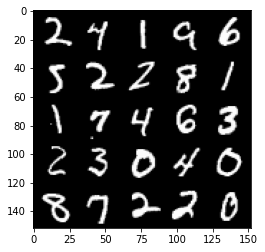

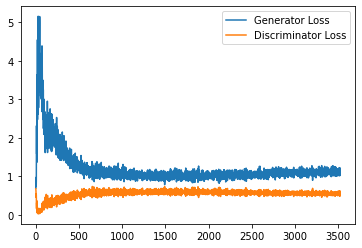

Step 71000: Generator loss: 1.1093652329444885, discriminator loss: 0.5466467853188515


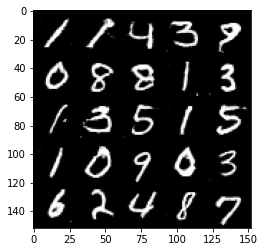

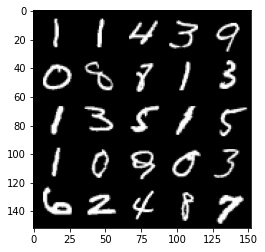

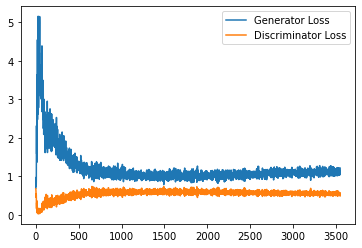

Step 71500: Generator loss: 1.1135750060081482, discriminator loss: 0.5553709192872047


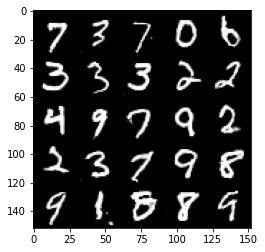

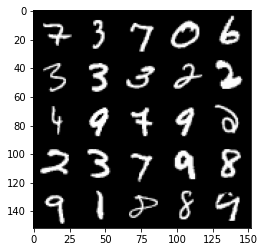

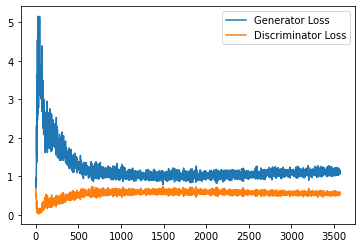

Step 72000: Generator loss: 1.0989063800573349, discriminator loss: 0.551758095741272


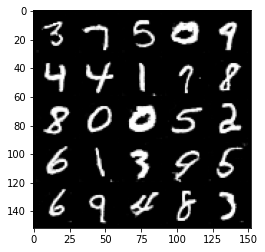

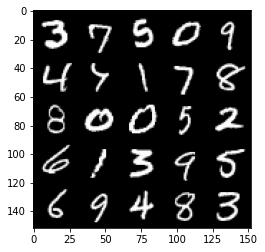

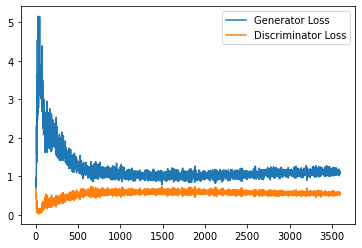

Step 72500: Generator loss: 1.1043862960338593, discriminator loss: 0.5516007524132729


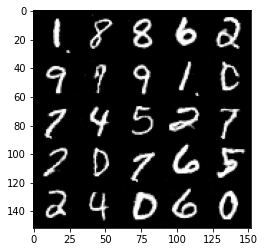

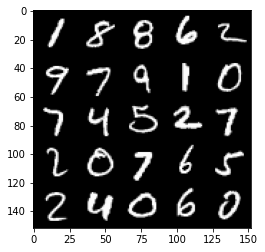

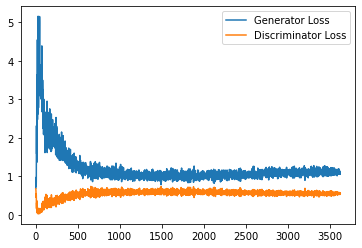

Step 73000: Generator loss: 1.1258033304214476, discriminator loss: 0.5549689160585404


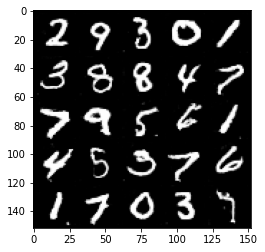

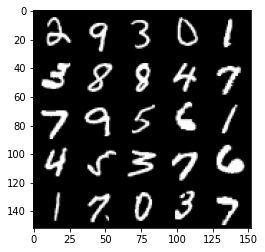

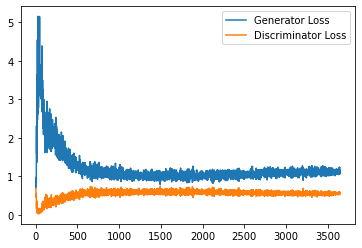

Step 73500: Generator loss: 1.094341870188713, discriminator loss: 0.5511442964673042


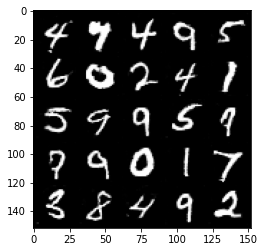

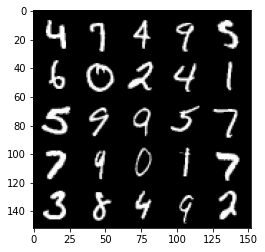

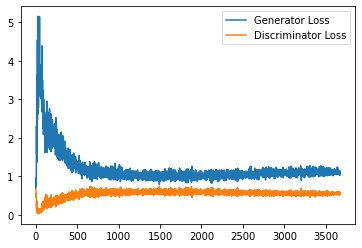

Step 74000: Generator loss: 1.1096279639005662, discriminator loss: 0.5573372351527214


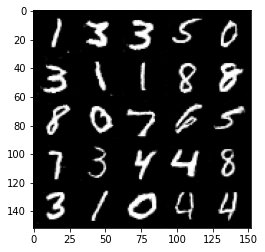

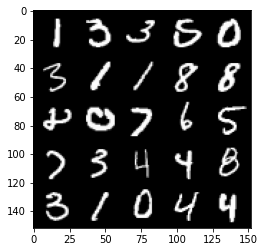

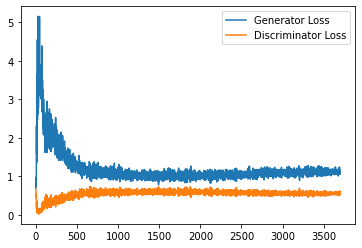

Step 74500: Generator loss: 1.1276480565071105, discriminator loss: 0.5543423593044281


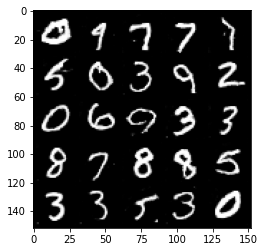

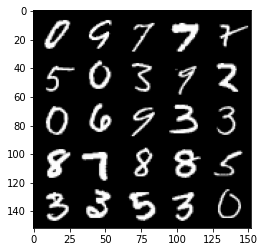

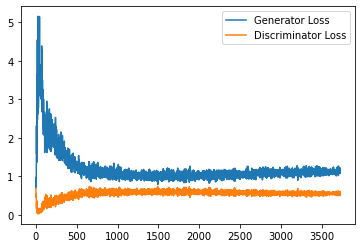

Step 75000: Generator loss: 1.1000595663785935, discriminator loss: 0.5573557935953141


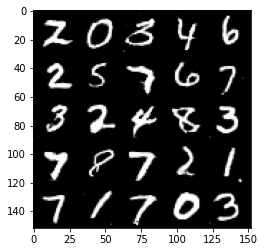

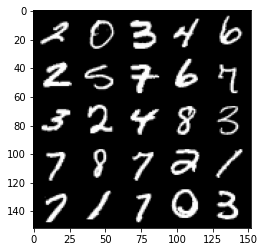

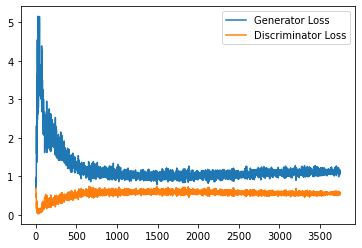

Step 75500: Generator loss: 1.1001056327819825, discriminator loss: 0.5609136564731598


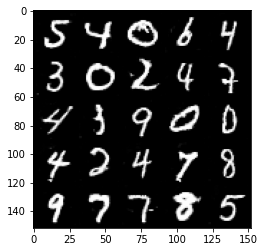

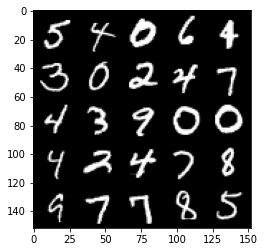

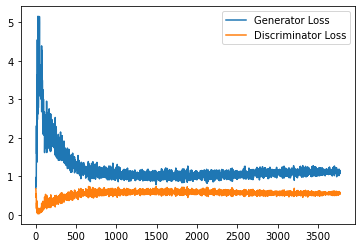

Step 76000: Generator loss: 1.0968641735315323, discriminator loss: 0.5616988134384155


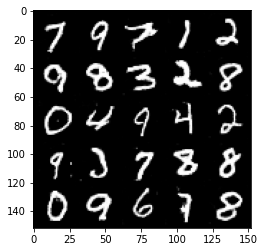

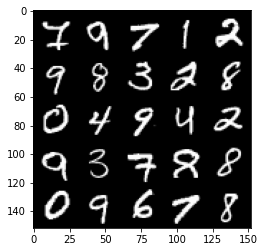

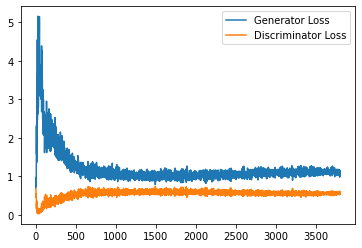

Step 76500: Generator loss: 1.1140772848129272, discriminator loss: 0.5590848822593689


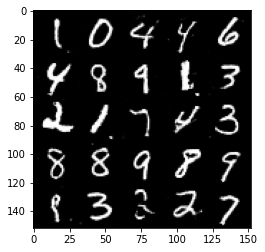

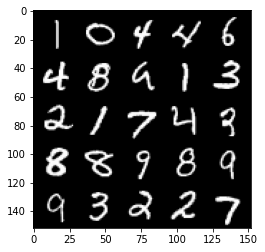

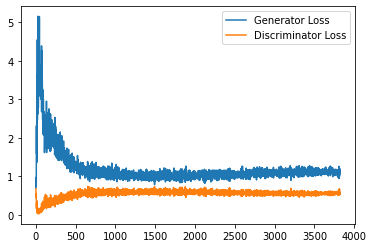

Step 77000: Generator loss: 1.0862058918476105, discriminator loss: 0.5632365986704826


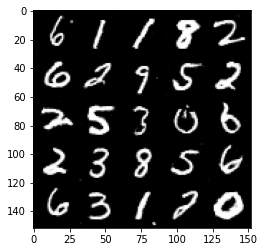

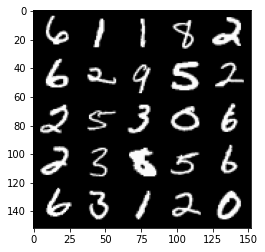

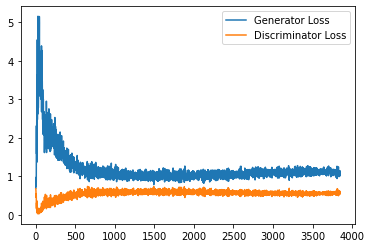

Step 77500: Generator loss: 1.0908504697084427, discriminator loss: 0.5590804068446159


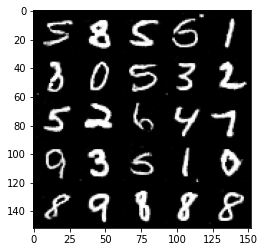

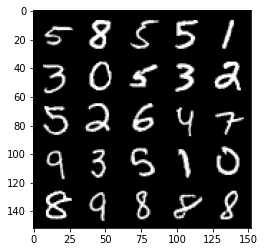

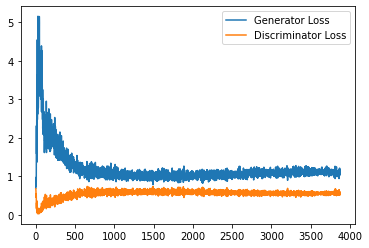

Step 78000: Generator loss: 1.1103958195447923, discriminator loss: 0.5613262190818786


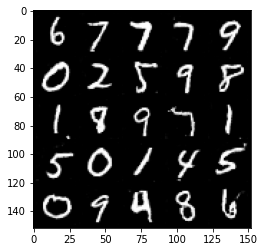

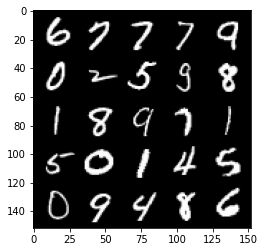

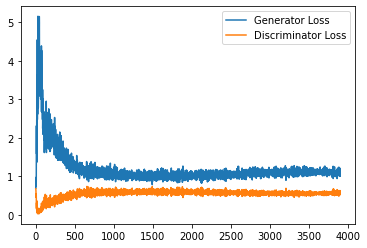

Step 78500: Generator loss: 1.1103315229415893, discriminator loss: 0.5611345123648643


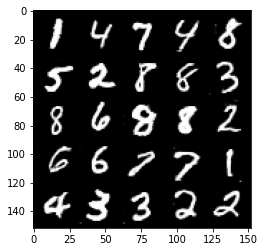

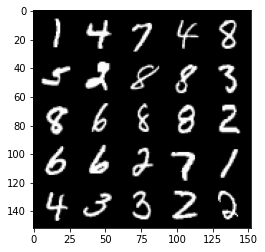

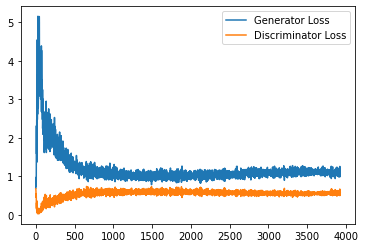

Step 79000: Generator loss: 1.1134724422693252, discriminator loss: 0.5635177311897278


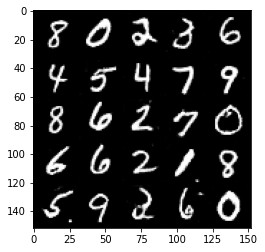

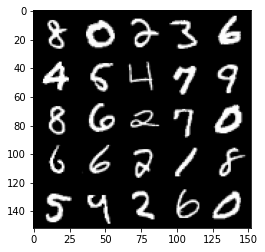

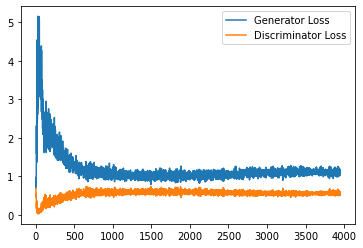

Step 79500: Generator loss: 1.0948263819217683, discriminator loss: 0.5689221772551537


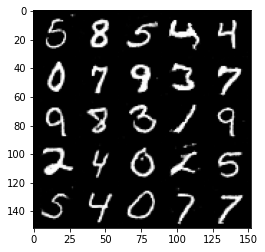

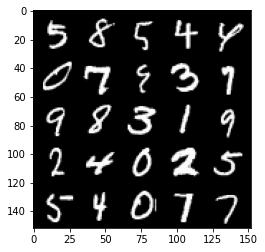

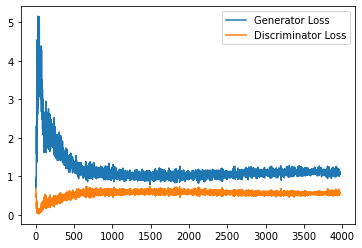

Step 80000: Generator loss: 1.1025968356132507, discriminator loss: 0.5633412730097771


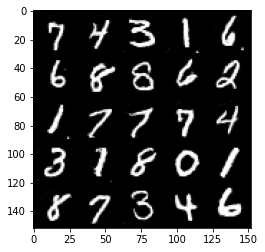

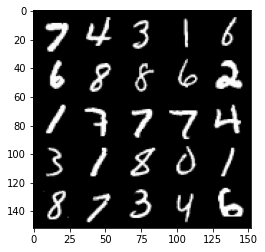

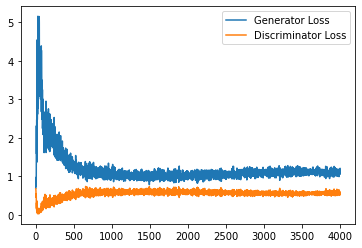

Step 80500: Generator loss: 1.085180291891098, discriminator loss: 0.5628882524967194


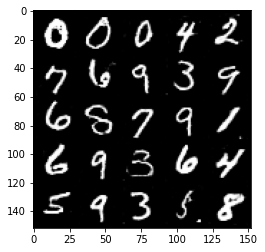

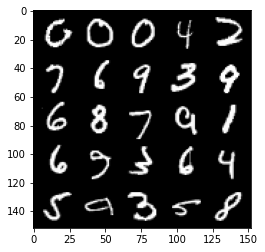

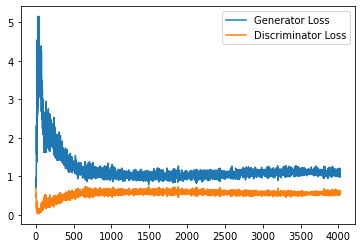

Step 81000: Generator loss: 1.0824058591127395, discriminator loss: 0.5648084574937821


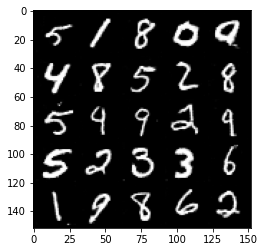

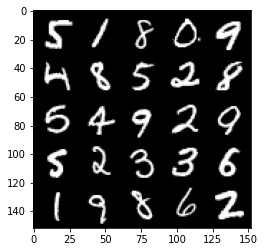

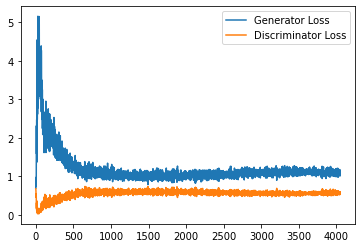

Step 81500: Generator loss: 1.1086583520174027, discriminator loss: 0.5694311287403107


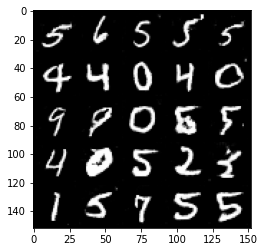

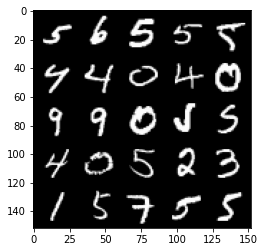

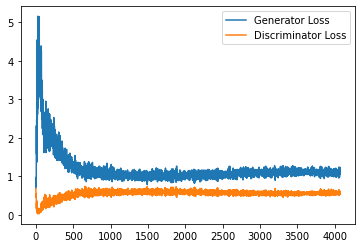

Step 82000: Generator loss: 1.117276049375534, discriminator loss: 0.5621384266614914


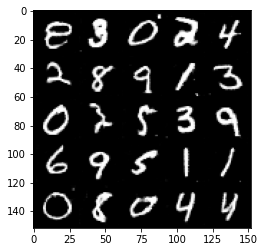

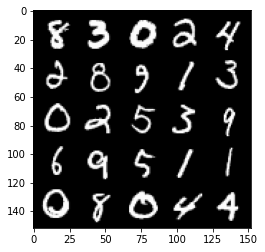

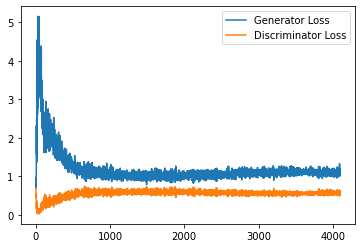

Step 82500: Generator loss: 1.110093273162842, discriminator loss: 0.5659449242949486


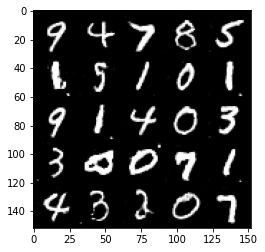

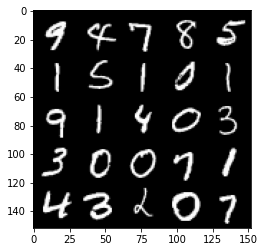

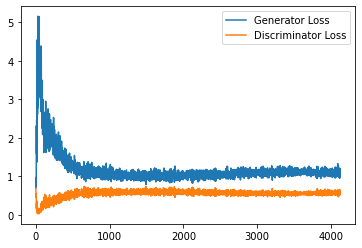

Step 83000: Generator loss: 1.1153342782258988, discriminator loss: 0.5590629122257232


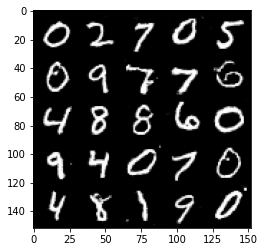

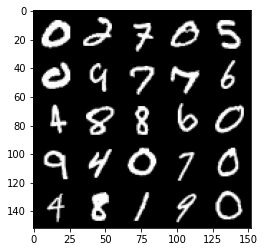

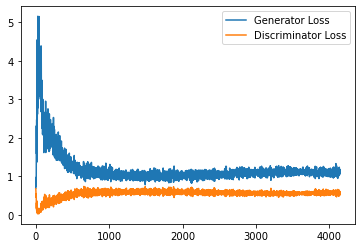

Step 83500: Generator loss: 1.1103539592027665, discriminator loss: 0.5647647606134415


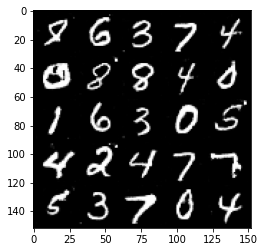

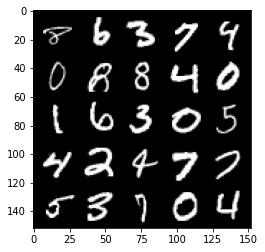

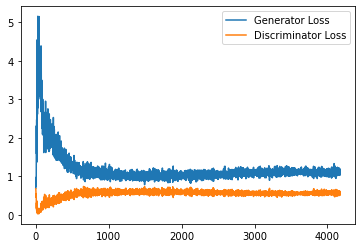

Step 84000: Generator loss: 1.1033375602960587, discriminator loss: 0.5631626592874527


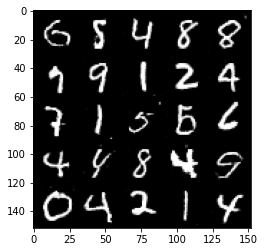

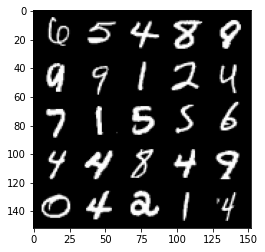

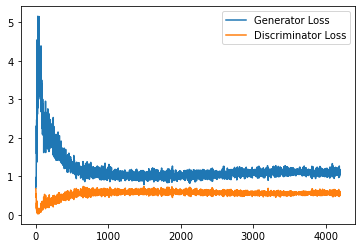

Step 84500: Generator loss: 1.1018933696746827, discriminator loss: 0.5684110132455826


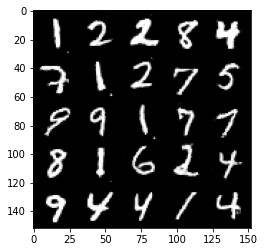

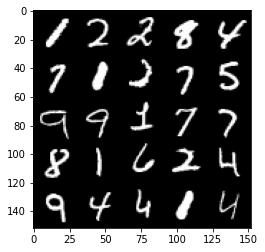

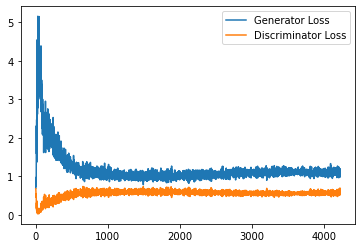

Step 85000: Generator loss: 1.1073779057264328, discriminator loss: 0.562239050924778


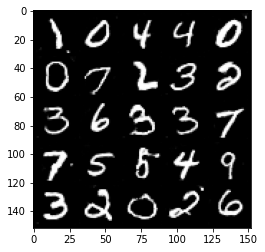

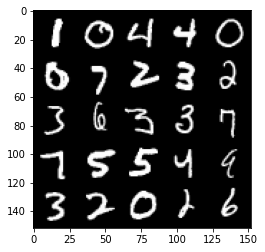

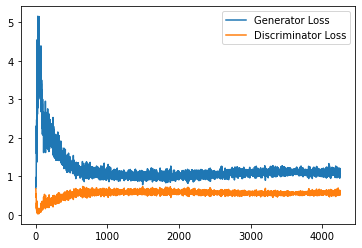

Step 85500: Generator loss: 1.1058659216165543, discriminator loss: 0.5643764117360115


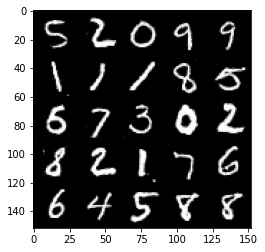

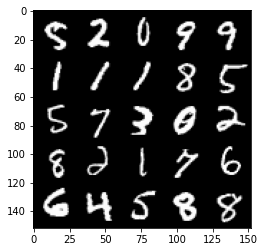

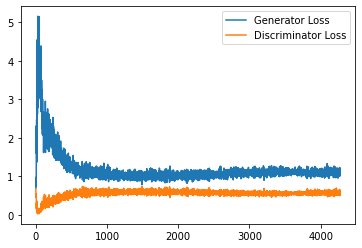

Step 86000: Generator loss: 1.1128187350034713, discriminator loss: 0.5637076354026794


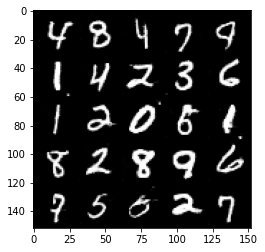

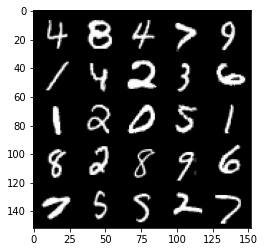

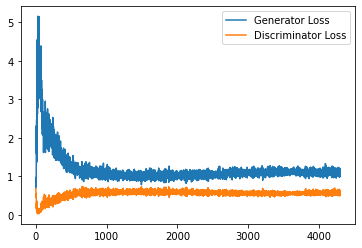

Step 86500: Generator loss: 1.1182809857130052, discriminator loss: 0.5657747995853424


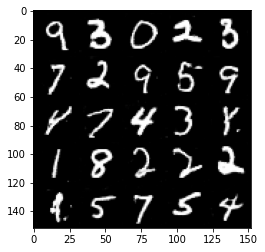

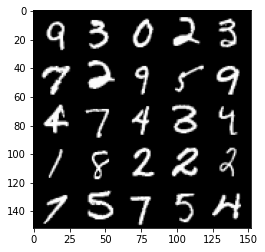

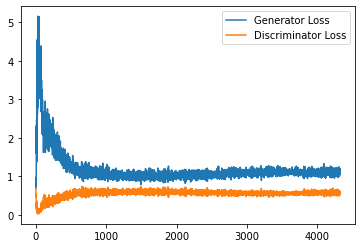

Step 87000: Generator loss: 1.0898839480876923, discriminator loss: 0.5691967150568962


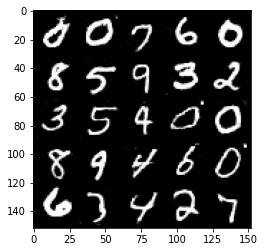

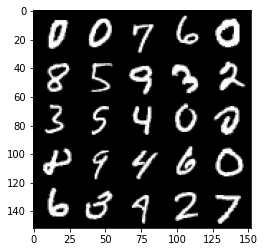

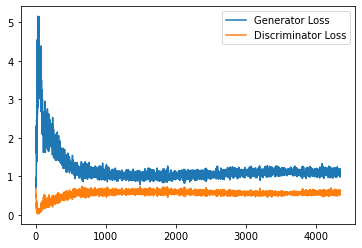

Step 87500: Generator loss: 1.1015096267461777, discriminator loss: 0.5677950446009636


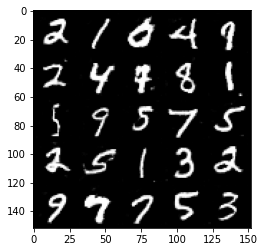

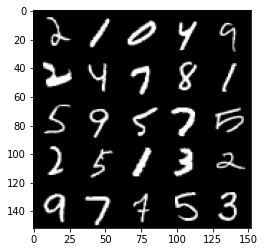

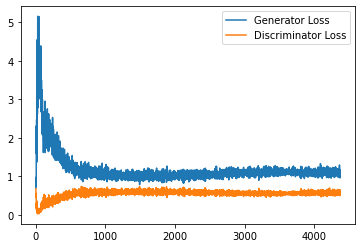

Step 88000: Generator loss: 1.1026642484664917, discriminator loss: 0.5694672517776489


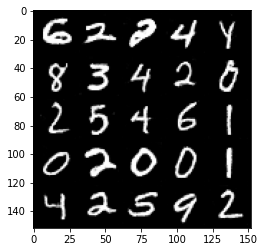

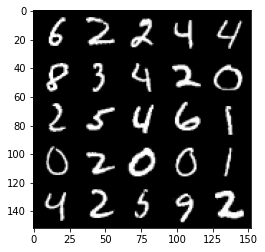

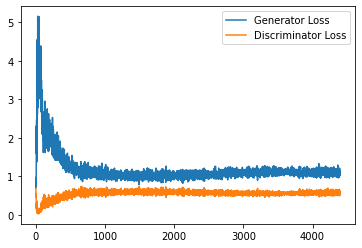

Step 88500: Generator loss: 1.0985153008699418, discriminator loss: 0.5642011966705323


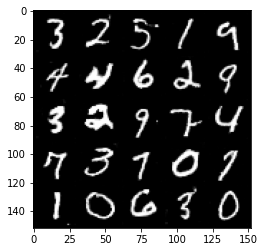

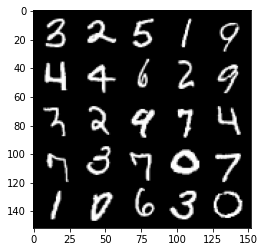

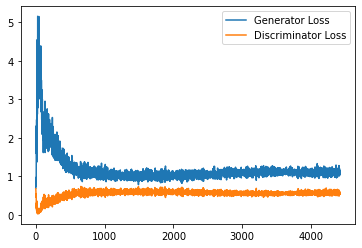

Step 89000: Generator loss: 1.1192051087617874, discriminator loss: 0.572536257326603


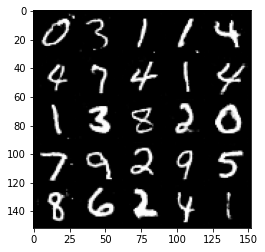

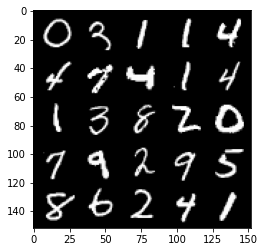

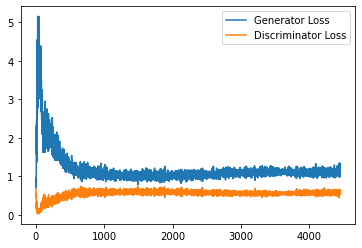

Step 89500: Generator loss: 1.104846845626831, discriminator loss: 0.5667541009187699


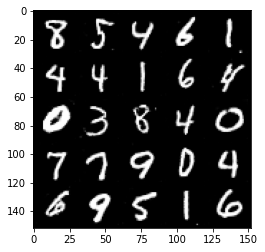

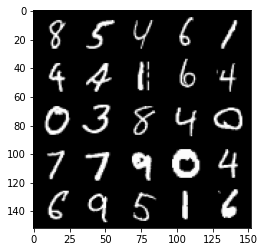

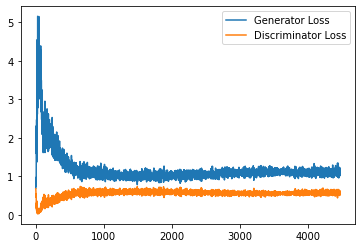

Step 90000: Generator loss: 1.0934836484193802, discriminator loss: 0.5729020115733147


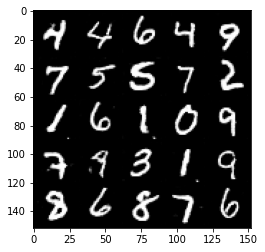

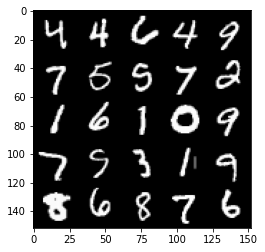

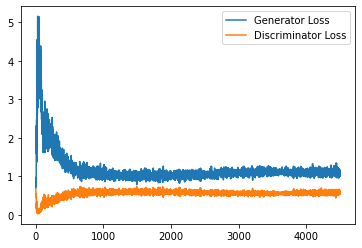

Step 90500: Generator loss: 1.1129763691425323, discriminator loss: 0.5667949779033661


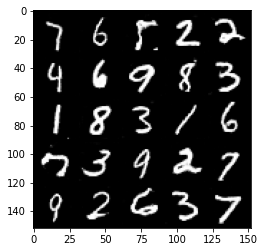

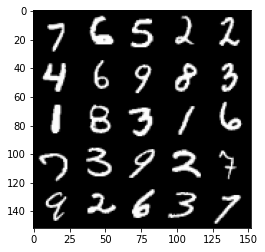

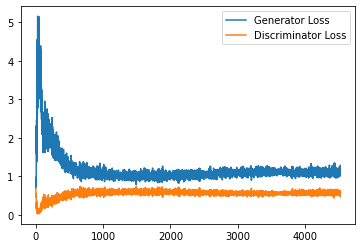

Step 91000: Generator loss: 1.1030615607500076, discriminator loss: 0.576652030646801


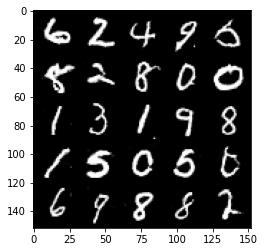

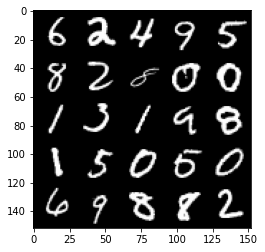

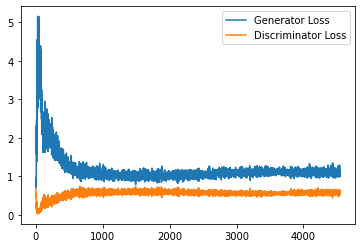

Step 91500: Generator loss: 1.1086735023260117, discriminator loss: 0.5640341063737869


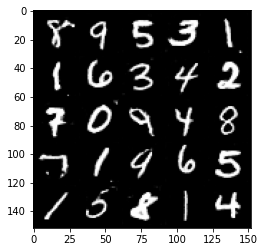

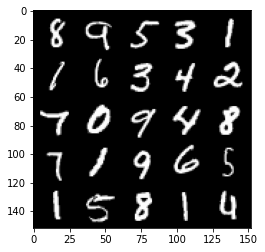

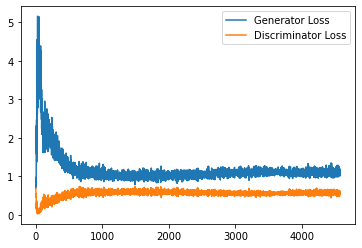

Step 92000: Generator loss: 1.1026766477823258, discriminator loss: 0.5643910702466964


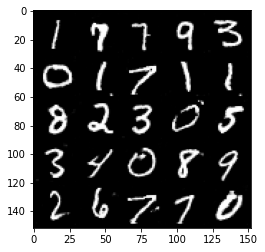

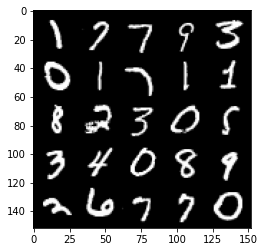

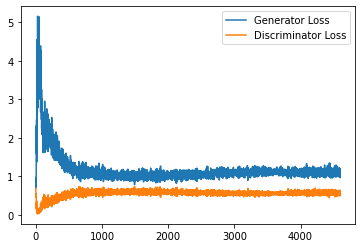

Step 92500: Generator loss: 1.1008708763122559, discriminator loss: 0.5693479719758033


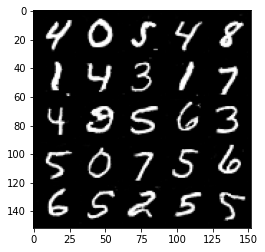

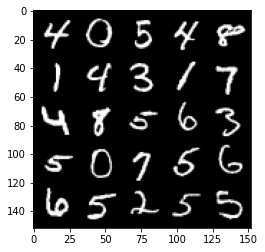

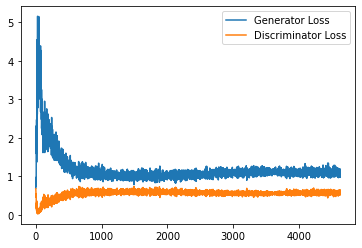

Step 93000: Generator loss: 1.1134646973609925, discriminator loss: 0.5745931369662285


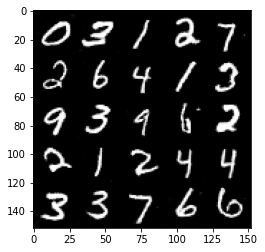

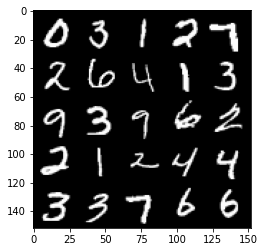

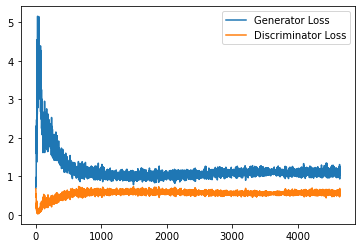

Step 93500: Generator loss: 1.1045925829410552, discriminator loss: 0.5739051650166511


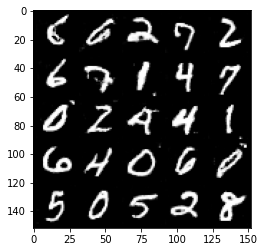

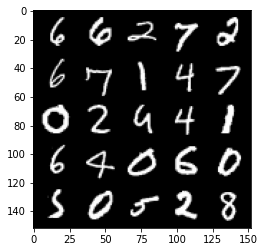

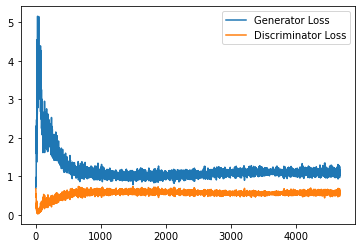

In [13]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [17]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

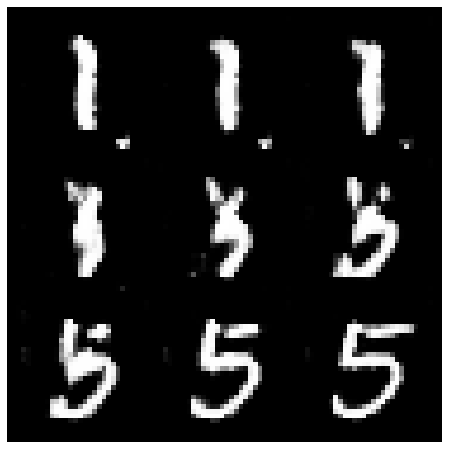

In [18]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

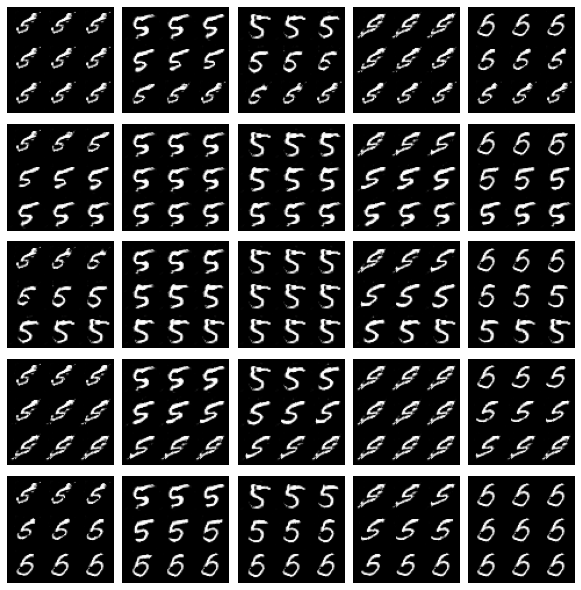

In [19]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()